# CP491 Mini Project
**โดย** <br>

*   นายธนิสร ธนาวิชญ์ 64102010077
*   นายณัฐวุฒิ ขาวสะอาด 64102010292


<h4>Define a dataset and data loader</h4>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from torch.utils.data import DataLoader
from torchvision import datasets

import os
workers = 0 if os.name == 'nt' else 4

def collate_fn(x):
    return x[0]

dataset = datasets.ImageFolder('/content/drive/MyDrive/test_images')
dataset.idx_to_class = {i:c for c, i in dataset.class_to_idx.items()}
loader = DataLoader(dataset, collate_fn=collate_fn, num_workers=workers)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


## Using facenet-pytorch pipeline

https://github.com/timesler/facenet-pytorch<br>
https://github.com/timesler/facenet-pytorch/blob/master/examples/infer.ipynb <br>
Code for accuracy check from https://machinelearningmastery.com/how-to-evaluate-the-performance-of-pytorch-models/

In [ ]:
import torch
import numpy as np
import pandas as pd

In [ ]:
# With pip:
!pip install facenet-pytorch

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 28.6 MB/s eta 0:00:00


In [ ]:
from facenet_pytorch import MTCNN, InceptionResnetV1

In [ ]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print('Running on device: {}'.format(device))

Running on device: cuda:0


<h4>Define MTCNN module</h4>

In [ ]:
mtcnn = MTCNN(
    image_size=160, margin=0, min_face_size=20,
    thresholds=[0.6, 0.7, 0.7], factor=0.709, post_process=True,
    device=device
)

<h4>Define Inception Resnet V1 module</h4>

In [ ]:
resnet = InceptionResnetV1(pretrained='vggface2').eval().to(device)

  0%|          | 0.00/107M [00:00<?, ?B/s]

<h4>Perfom MTCNN facial detection </h4>

In [ ]:
import matplotlib.pyplot as plt

aligned = []
names = []

print("Accuracy will use later for Performance Comparison")
for x, y in loader:
  x_aligned, prob = mtcnn(x, return_prob=True)
  y_pred = mtcnn(x)
  if y_pred is not None:
    acc = (y_pred.round()).float().mean()
    acc = float(acc)
    print(f"--------------------------------------")
    print(f"accuracy {acc}")
    print('Face detected with probability: {:8f}'.format(prob))
    aligned.append(x_aligned)
    names.append(dataset.idx_to_class[y])
  else:
    print(f"--------------------------------------")
    print("No face detected in this image.")
    plt.imshow(x)  # แสดงภาพที่ไม่สามารถตรวจจับใบหน้าได้
    plt.show()


Accuracy will use later for Performance Comparison


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


--------------------------------------
accuracy -0.2605338394641876
Face detected with probability: 0.998218
--------------------------------------
accuracy -0.06154948100447655
Face detected with probability: 0.999781
--------------------------------------
accuracy -0.08488281071186066
Face detected with probability: 0.994918
--------------------------------------
accuracy 0.032213542610406876
Face detected with probability: 0.998899
--------------------------------------
accuracy -0.10334635525941849
Face detected with probability: 0.990820
--------------------------------------
accuracy -0.15065103769302368
Face detected with probability: 0.999907
--------------------------------------
accuracy 0.1680729240179062
Face detected with probability: 0.999368
--------------------------------------
accuracy -0.21417969465255737
Face detected with probability: 0.999089
--------------------------------------
accuracy 0.12541666626930237
Face detected with probability: 0.999435
--------------

In [ ]:
aligned = torch.stack(aligned).to(device)

Emmy


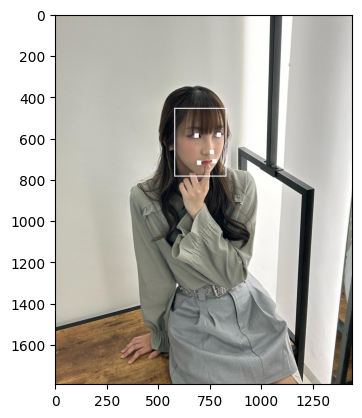

Emmy


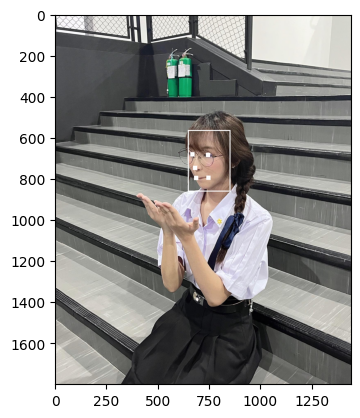

Emmy


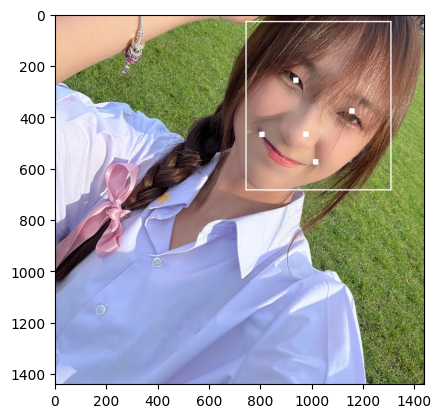

Emmy


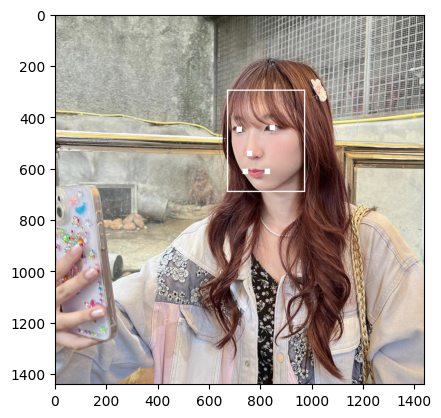

Emmy


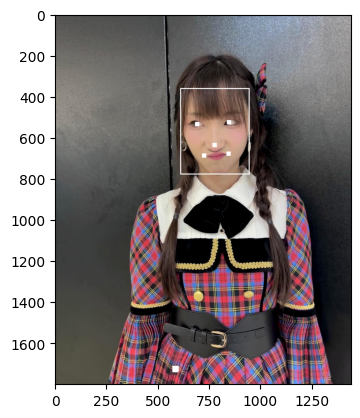

Emmy


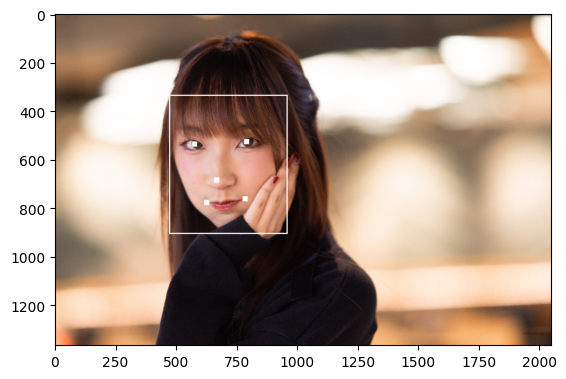

Emmy


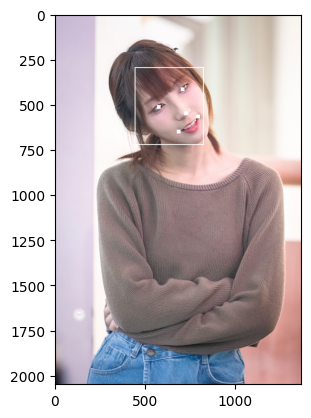

Emmy


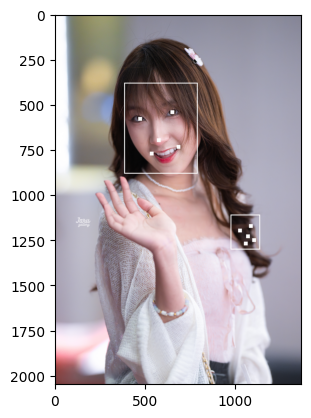

Emmy


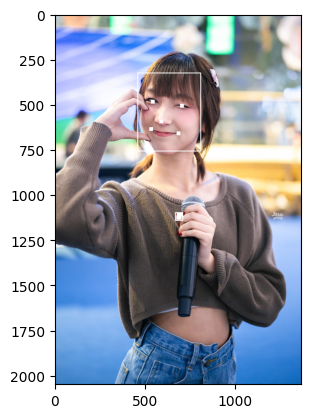

Emmy


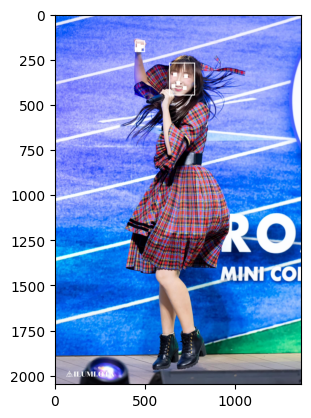

Endu


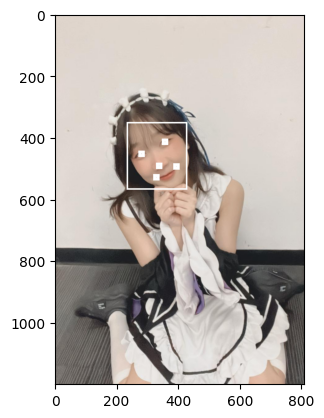

Endu


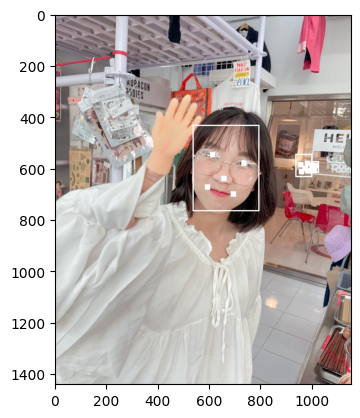

Endu


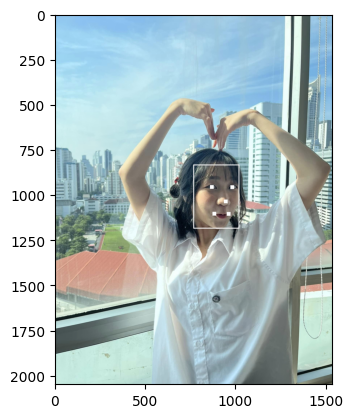

Endu


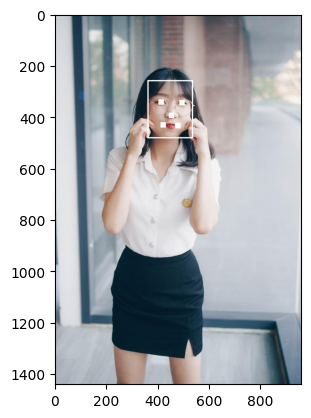

Endu


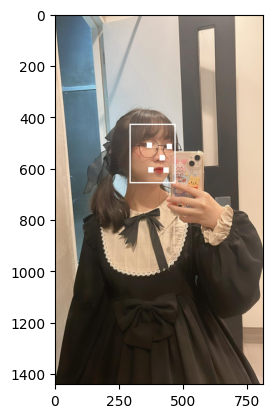

Endu


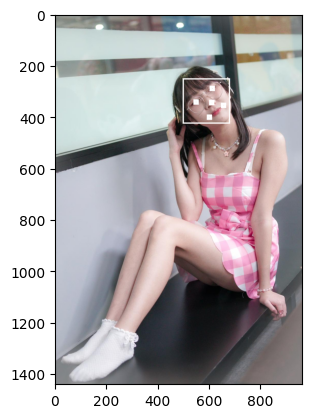

Endu


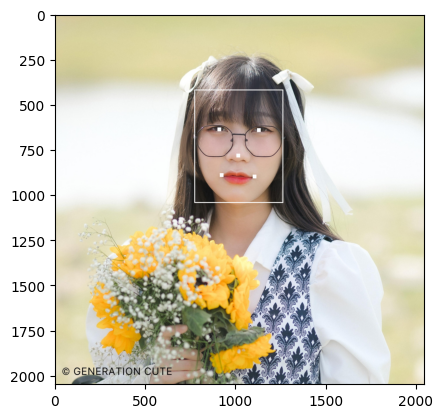

Endu


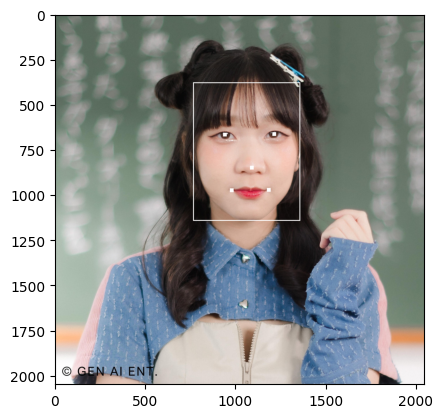

Endu


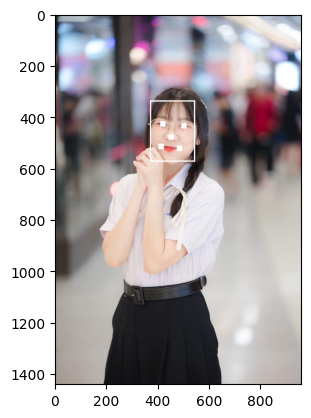

Endu


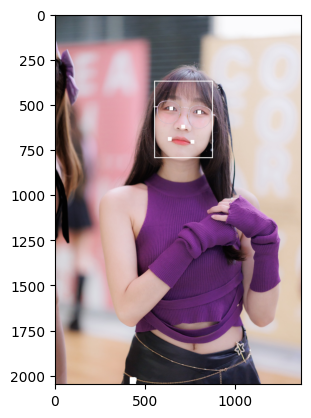

Fond


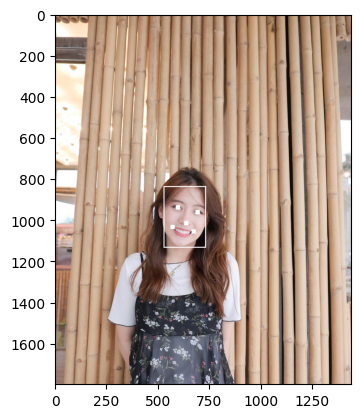

Fond


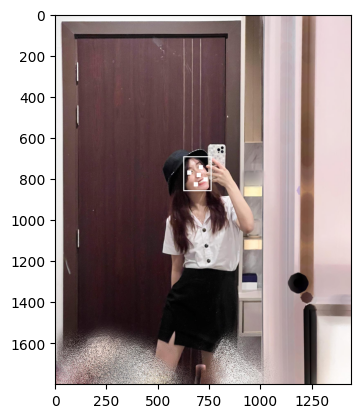

Fond


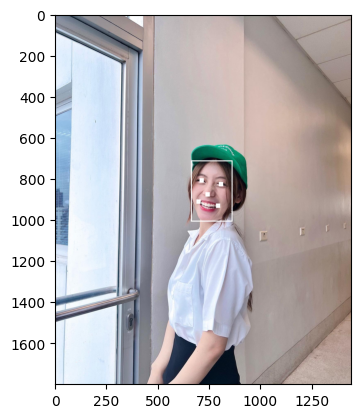

Fond


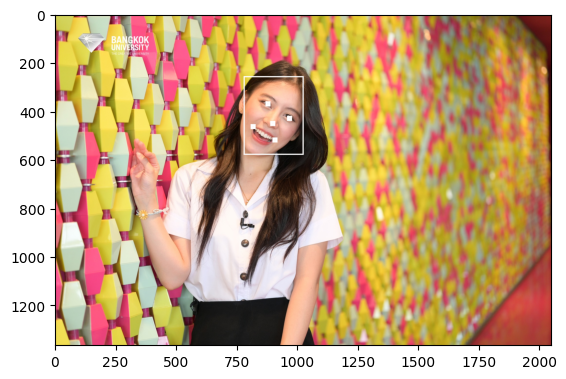

Fond


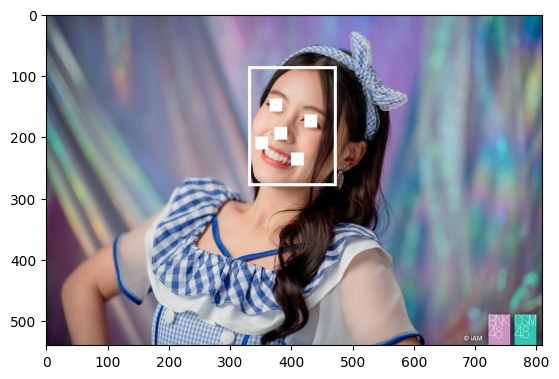

Fond


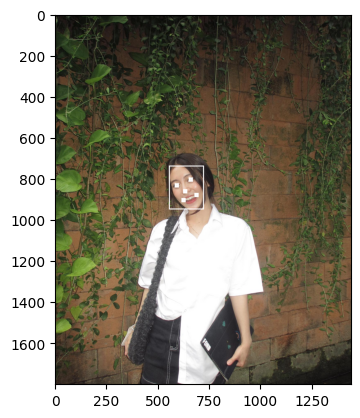

Fond


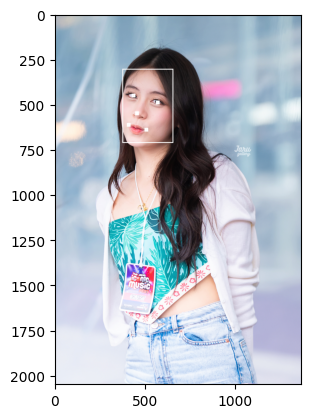

Fond


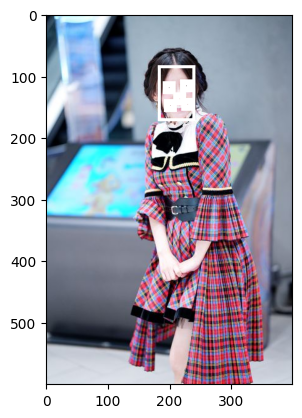

Fond


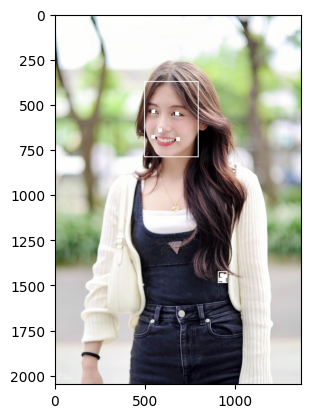

Fond


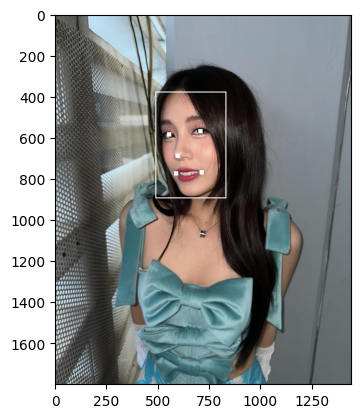

Ginna


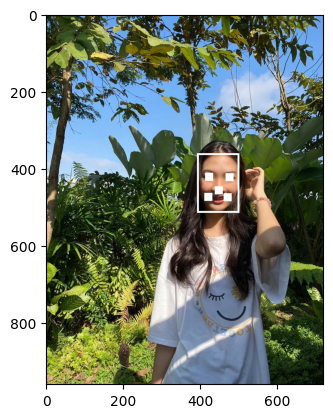

Ginna


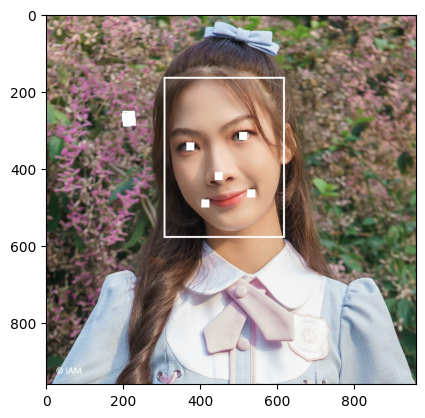

Ginna


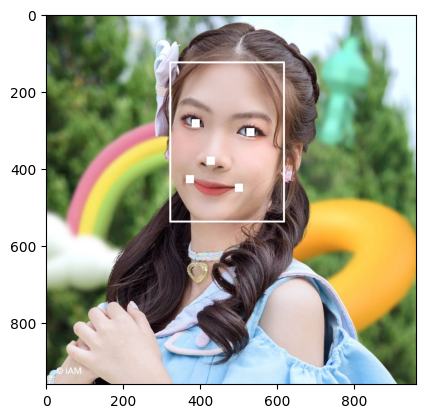

Ginna


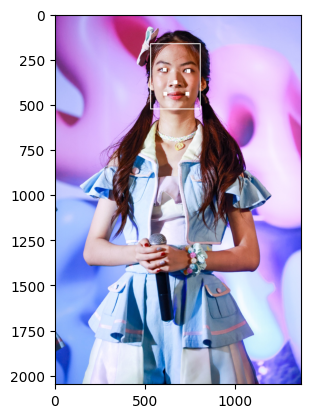

Ginna


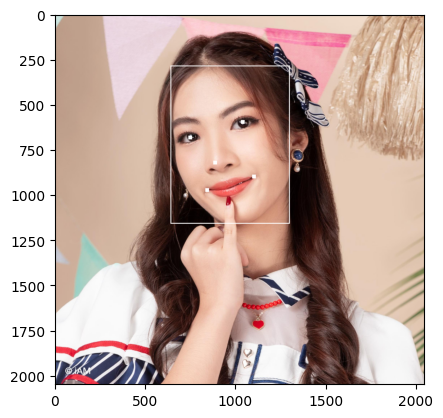

Ginna


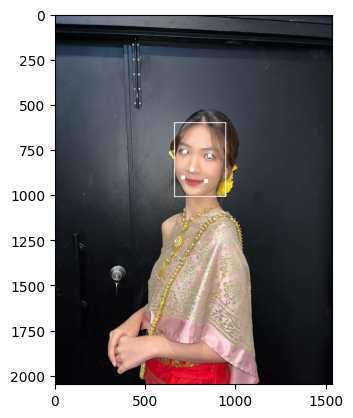

Ginna


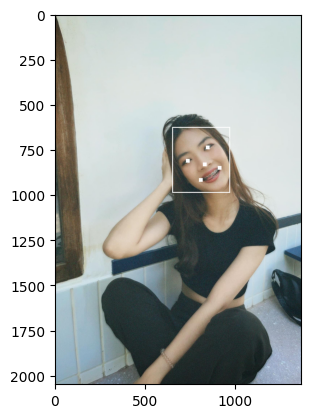

Ginna


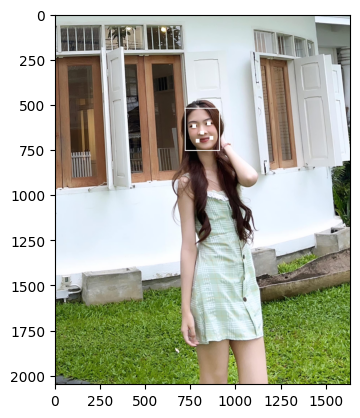

Ginna


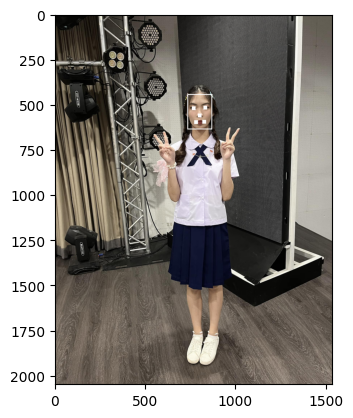

Ginna


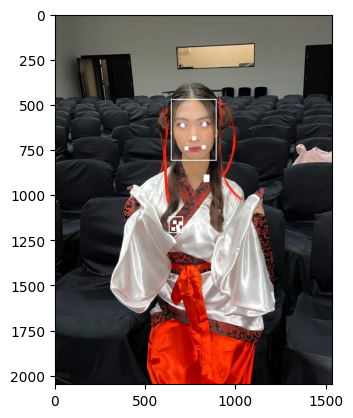

Grace


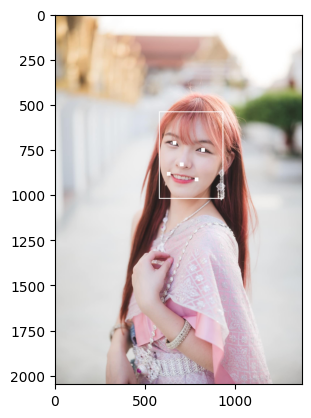

Grace


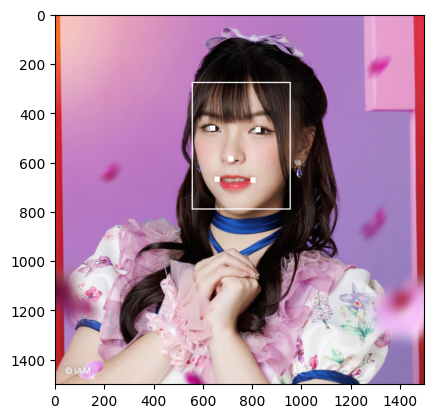

Grace


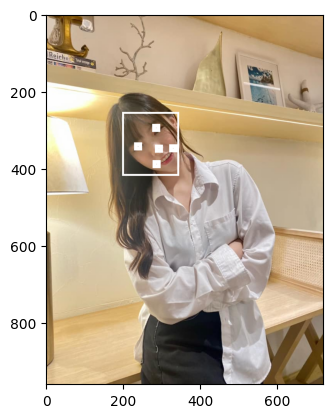

Grace


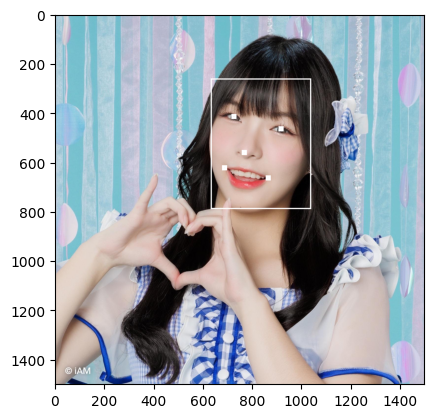

Grace


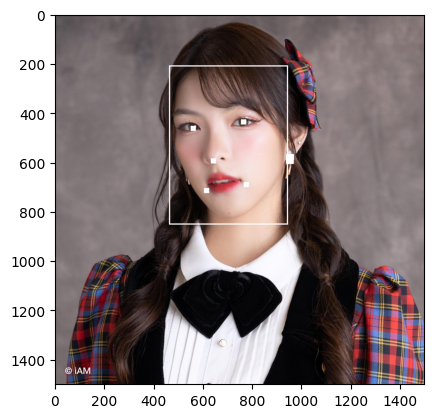

Grace


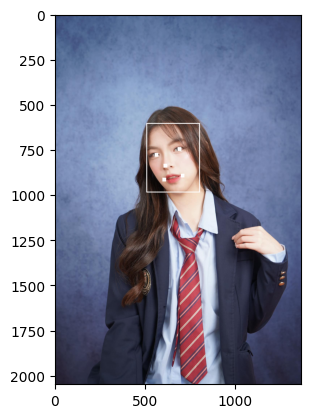

Grace


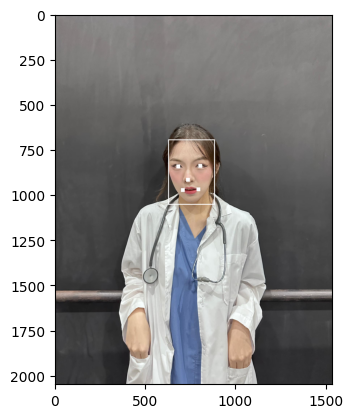

Grace


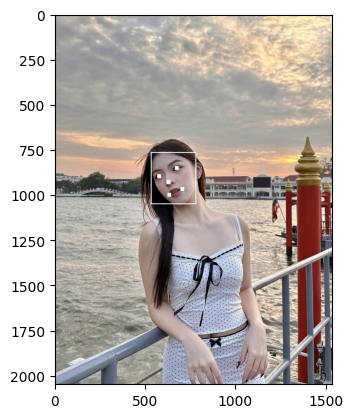

Grace


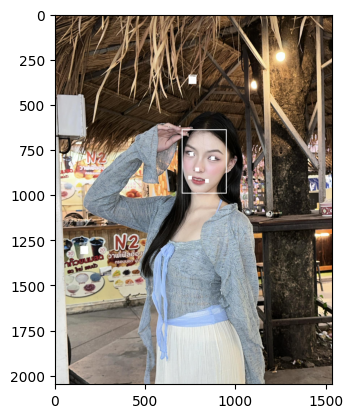

Grace


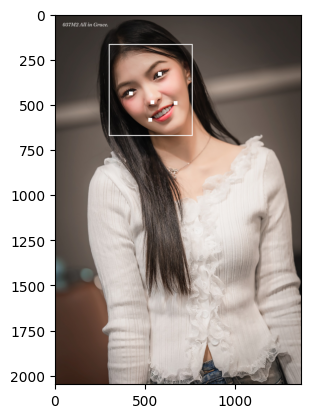

Gracenae


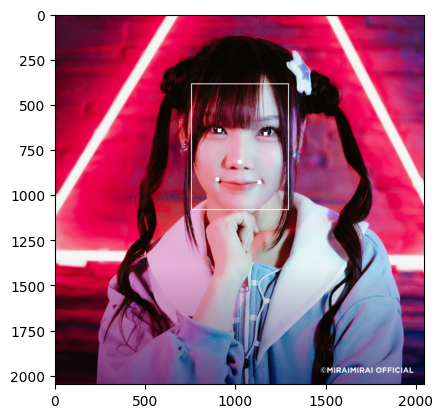

Gracenae


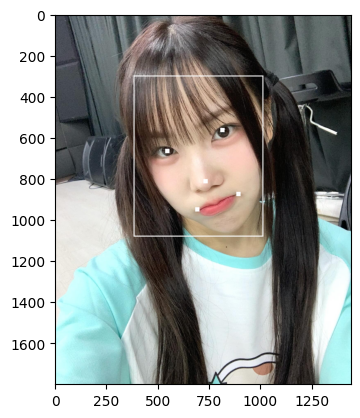

Gracenae


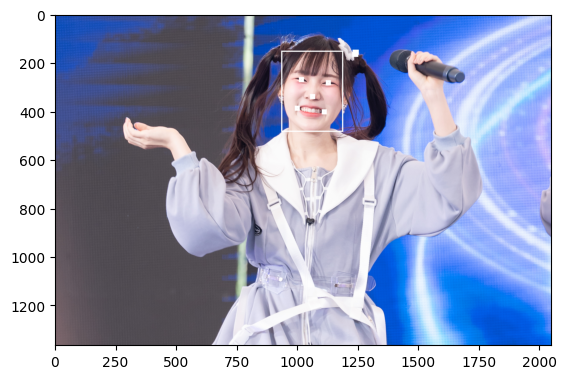

Gracenae


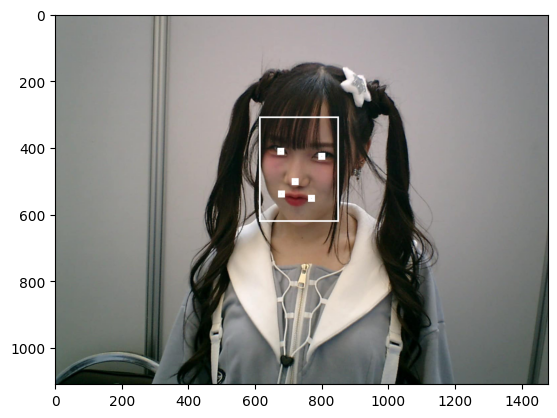

Gracenae


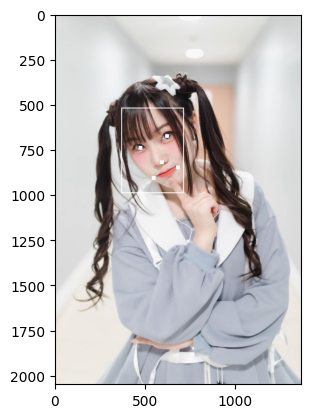

Gracenae


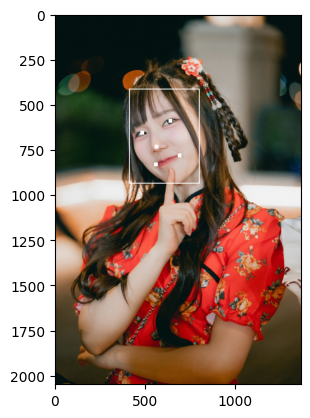

Gracenae


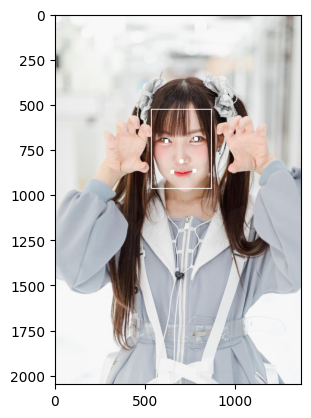

Gracenae


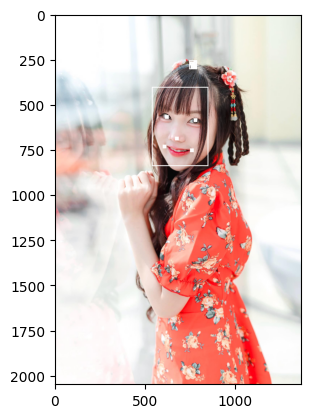

Gracenae


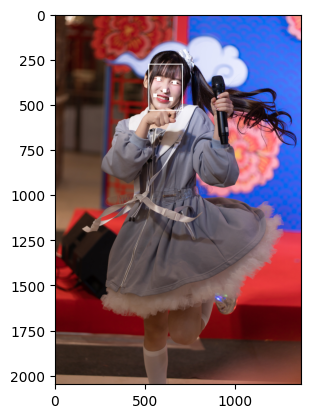

Gracenae


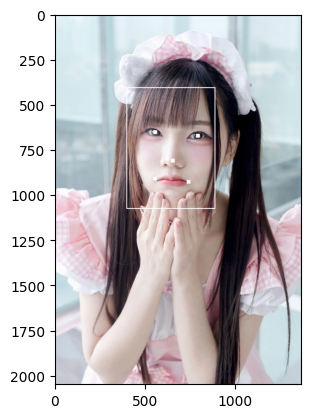

Jajah


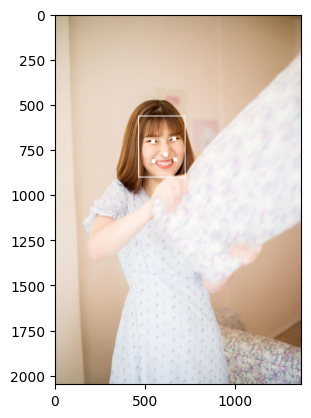

Jajah


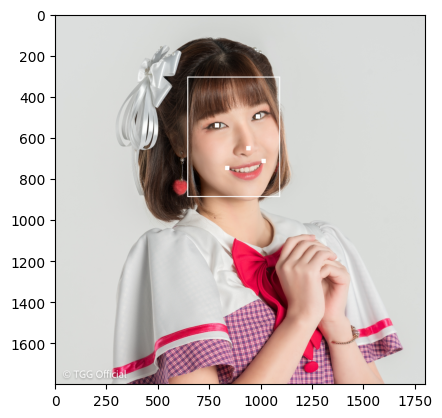

Jajah


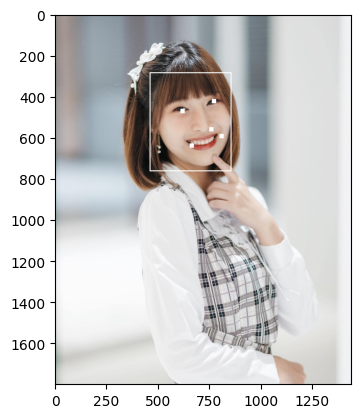

Jajah


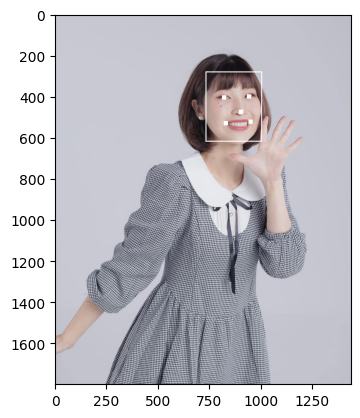

Jajah


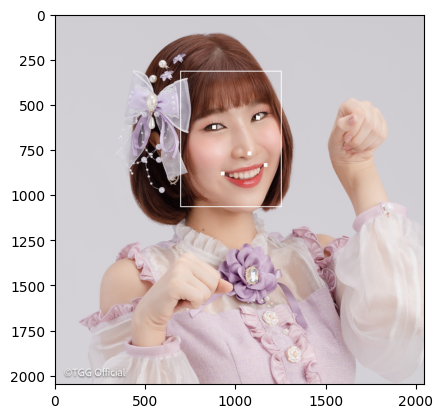

Jajah


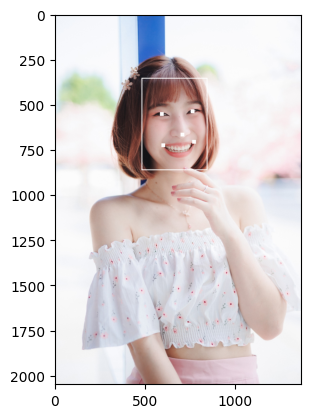

Jajah


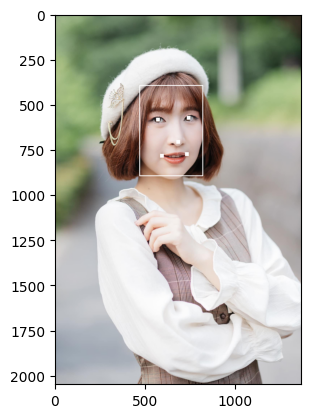

Jajah


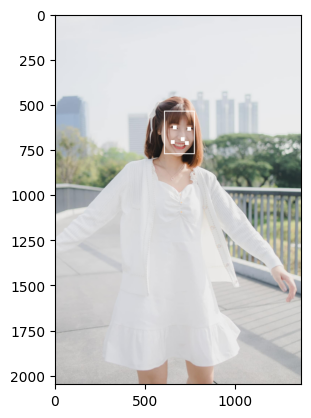

Jajah


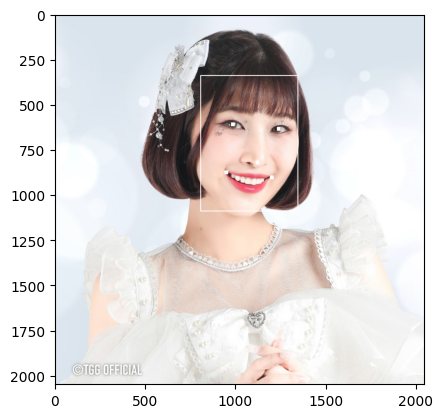

Jajah


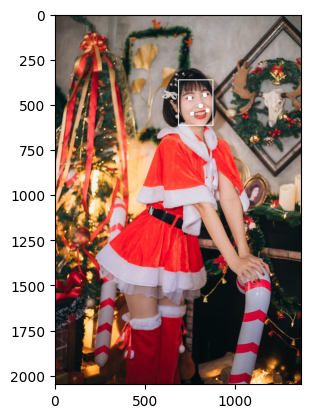

L


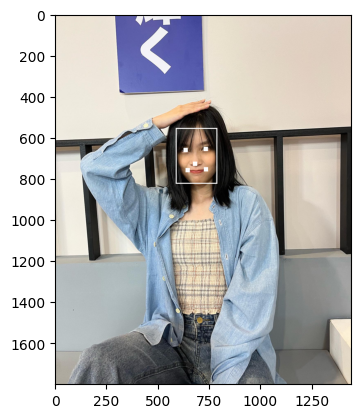

L


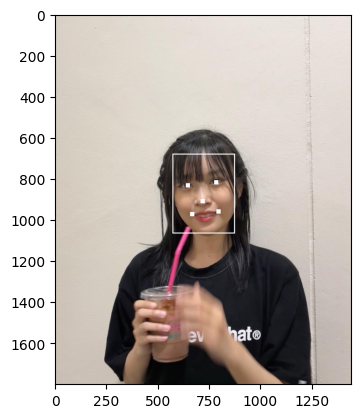

L


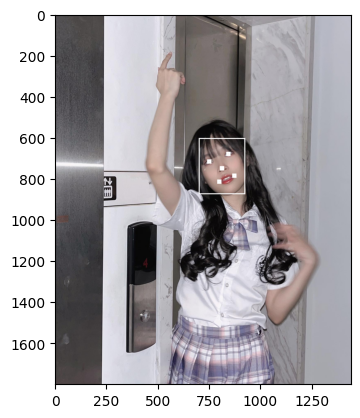

L


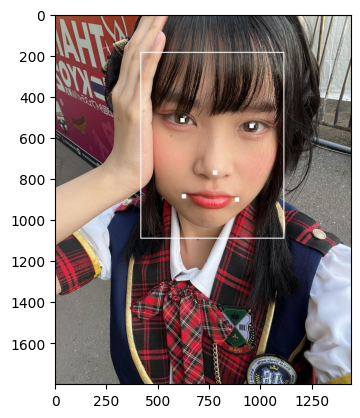

L


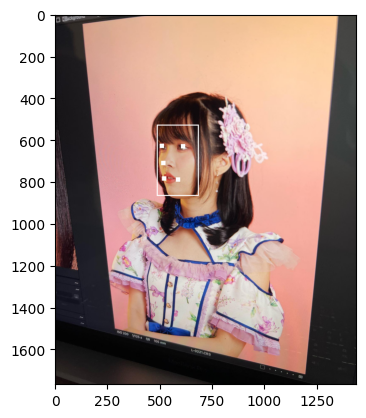

L


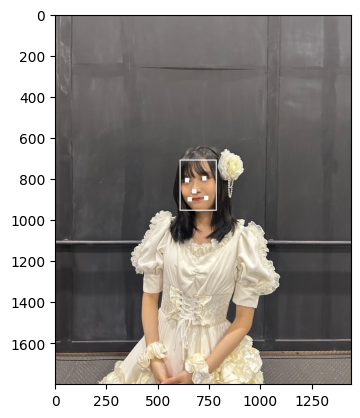

L


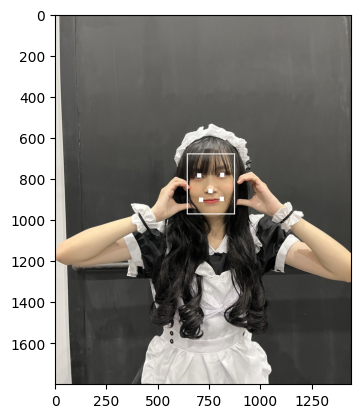

L


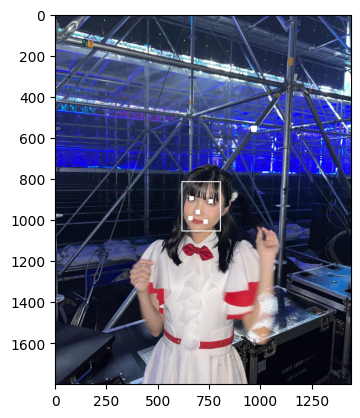

L


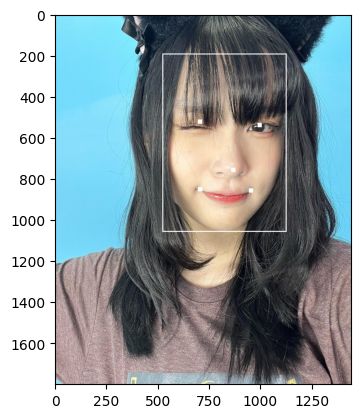

L


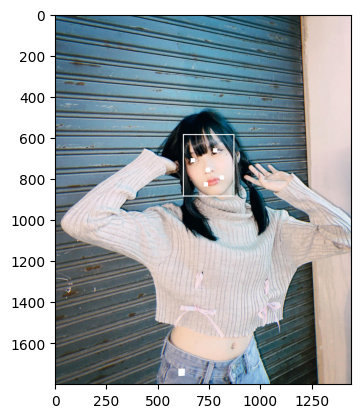

Lookked


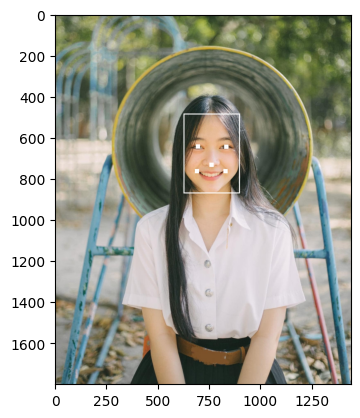

Lookked


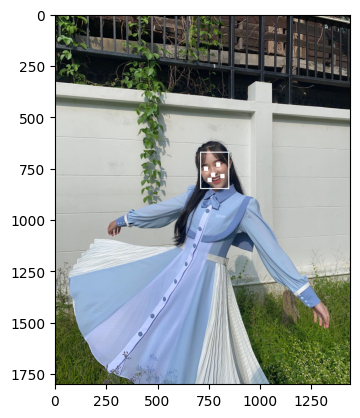

Lookked


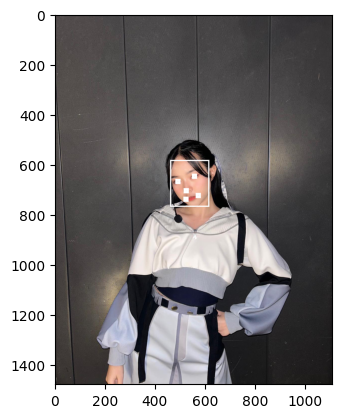

Lookked


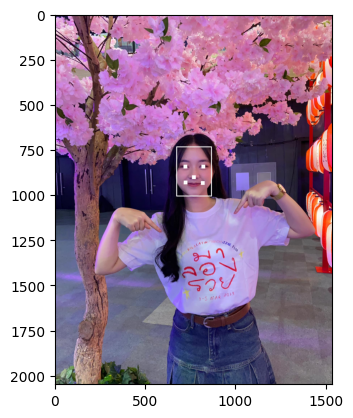

Lookked


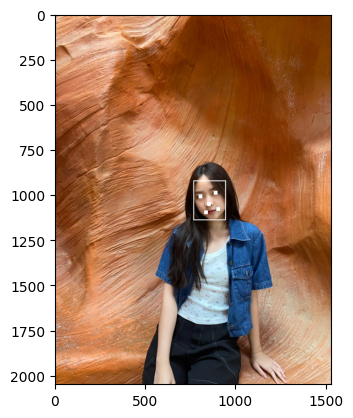

Lookked


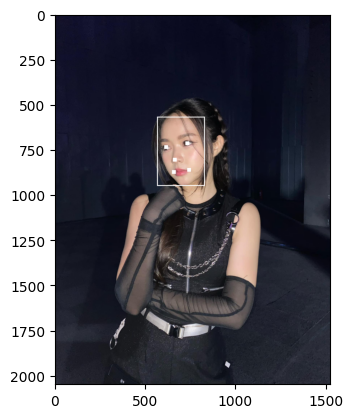

Lookked


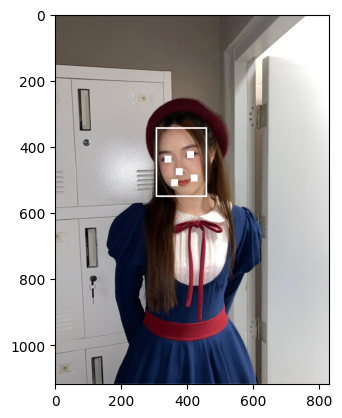

Lookked


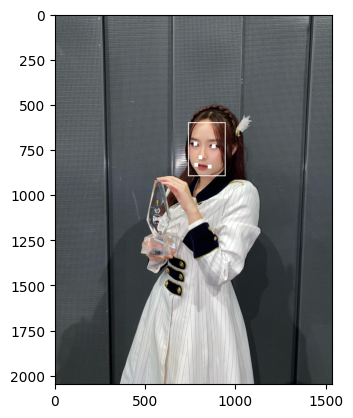

Lookked


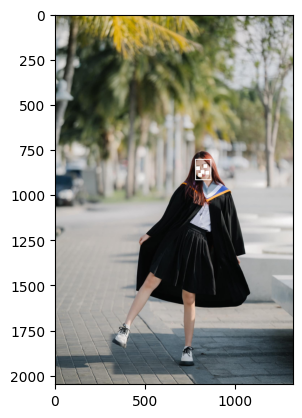

Lookked


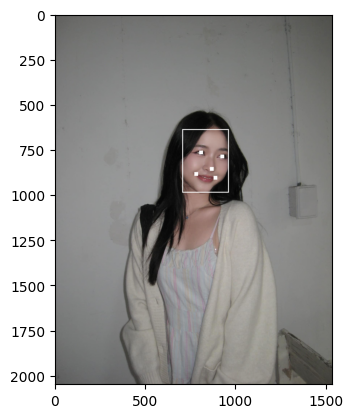

Mewyu


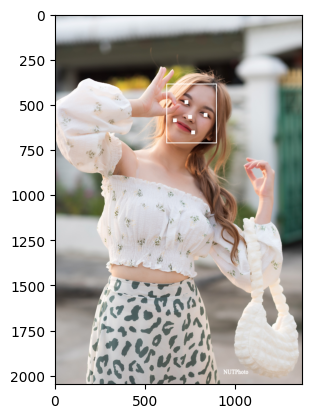

Mewyu


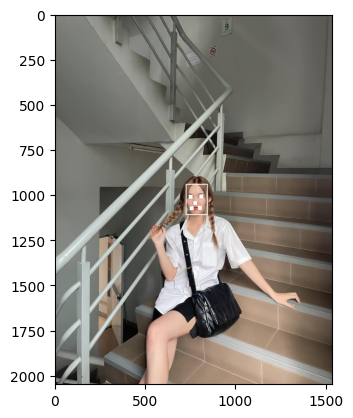

Mewyu


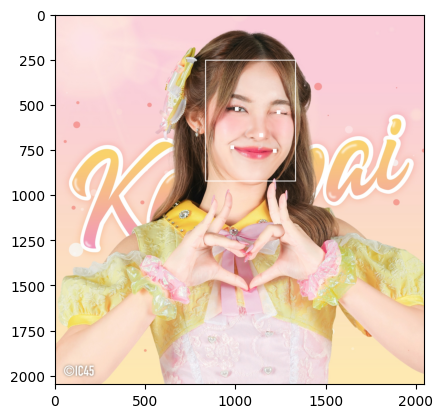

Mewyu


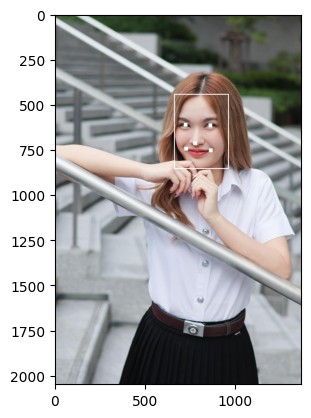

Mewyu


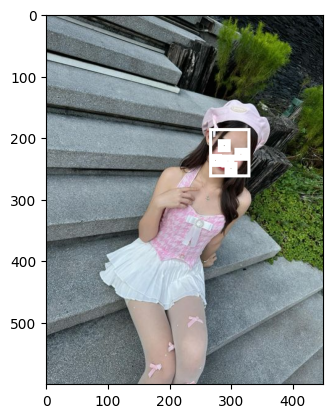

Mewyu


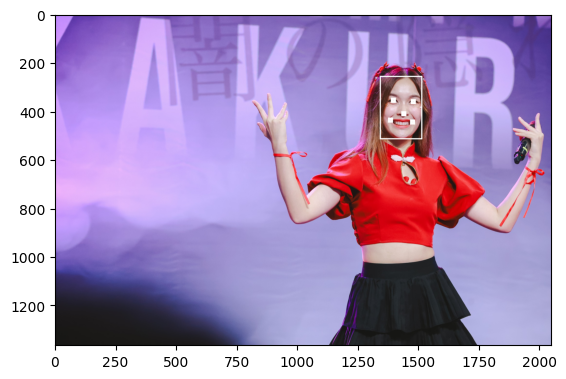

Mewyu


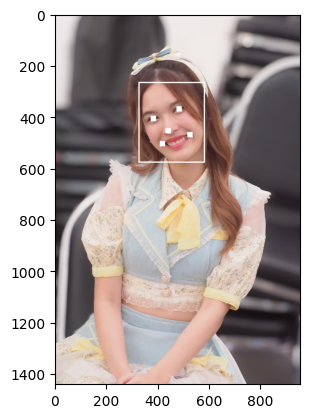

Mewyu


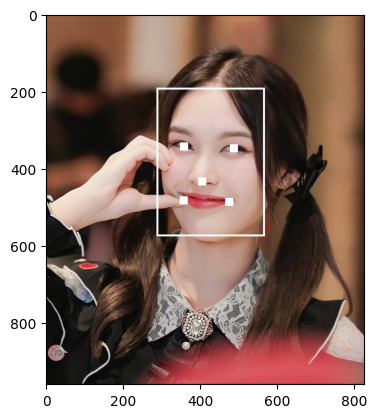

Mewyu


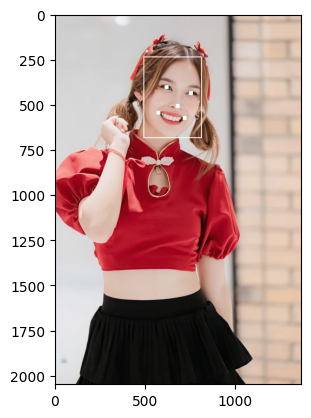

Mewyu


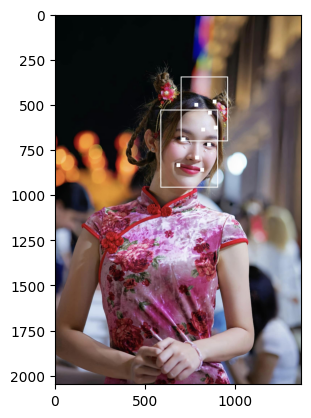

Micha


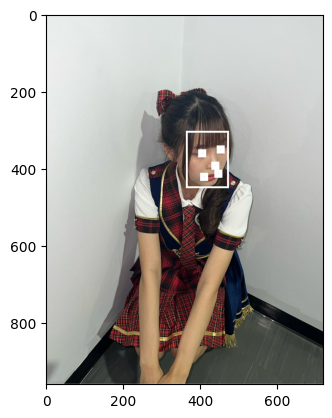

Micha


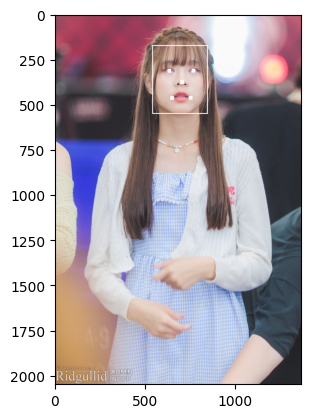

Micha


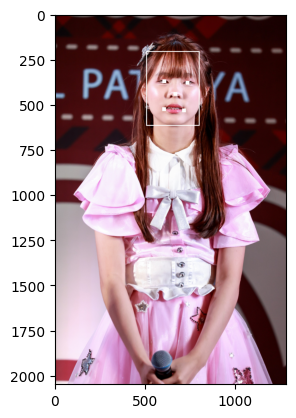

Micha


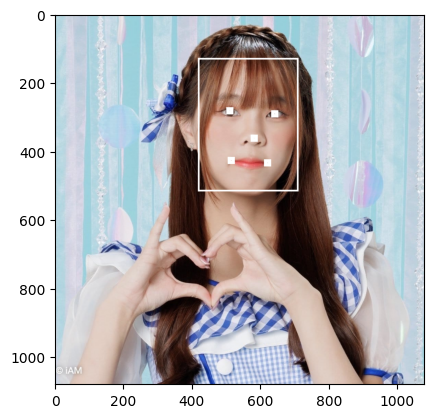

Micha


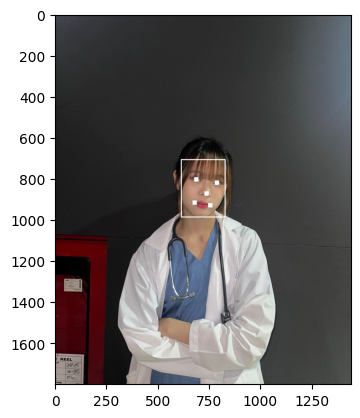

Micha


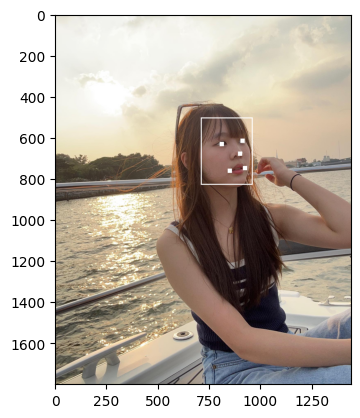

Micha


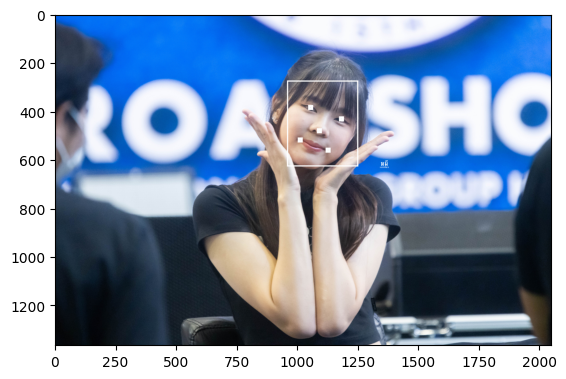

Micha


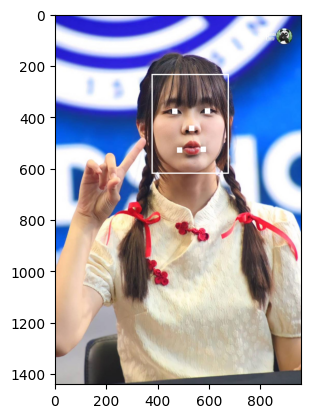

Micha


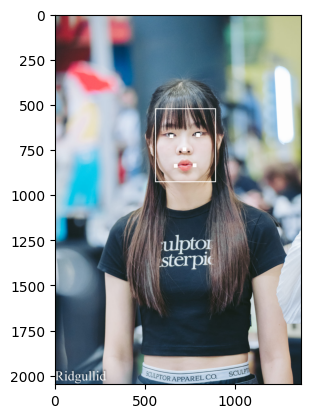

Micha


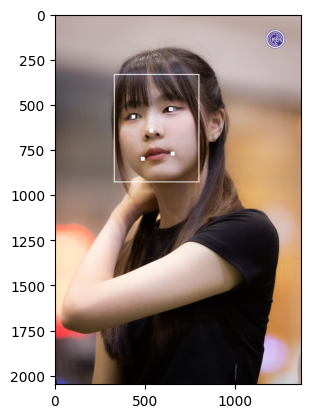

Nana


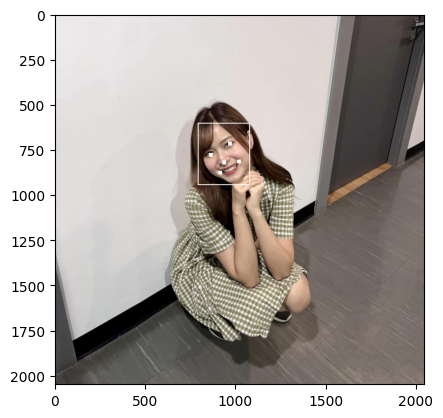

Nana


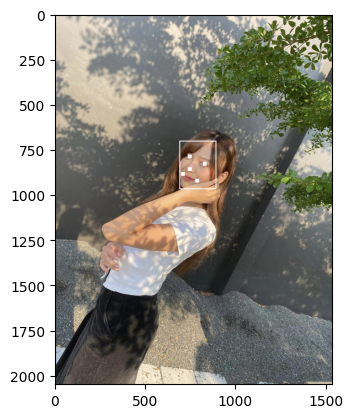

Nana


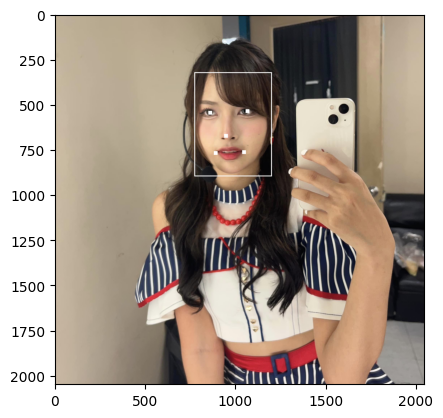

Nana


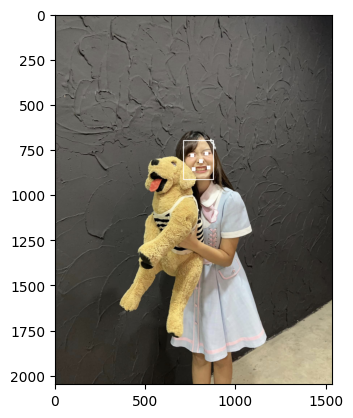

Nana


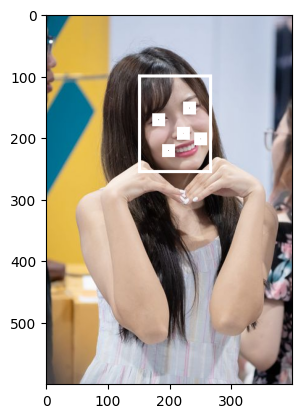

Nana


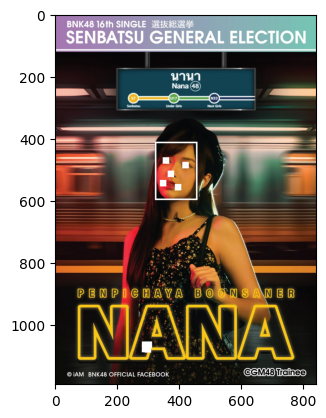

Nana


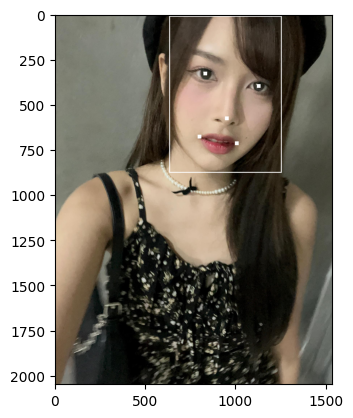

Nana


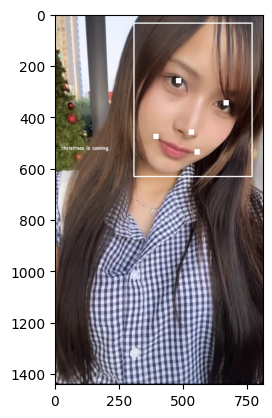

Nana


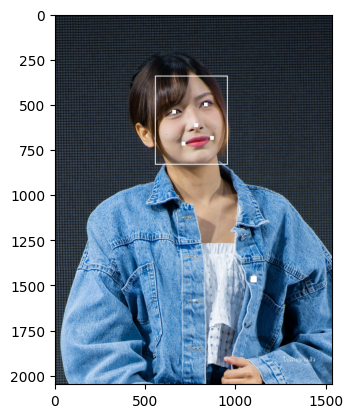

Nana


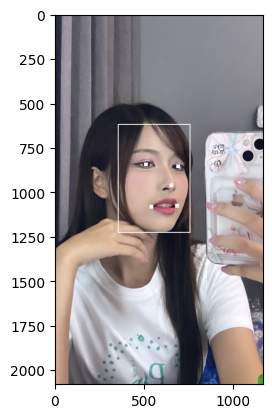

Paeyah


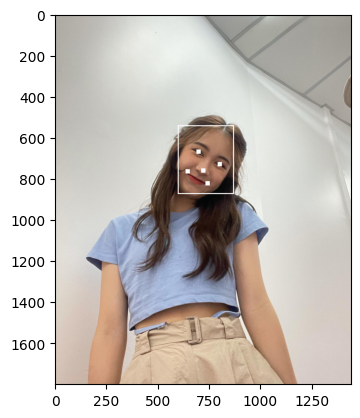

Paeyah


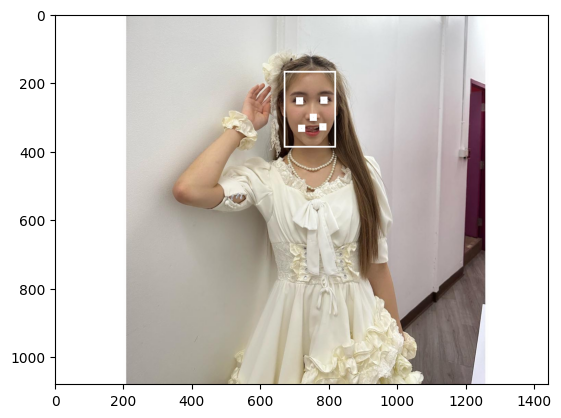

Paeyah


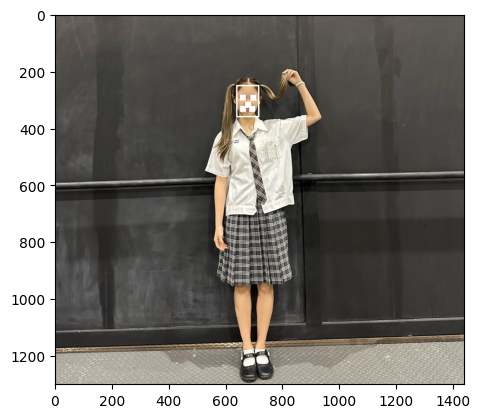

Paeyah


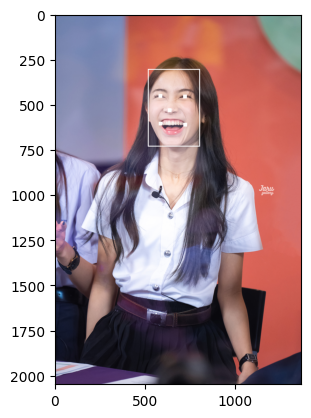

Paeyah


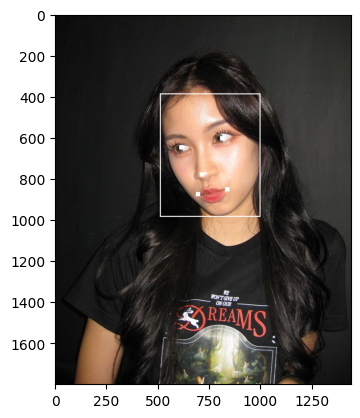

Paeyah


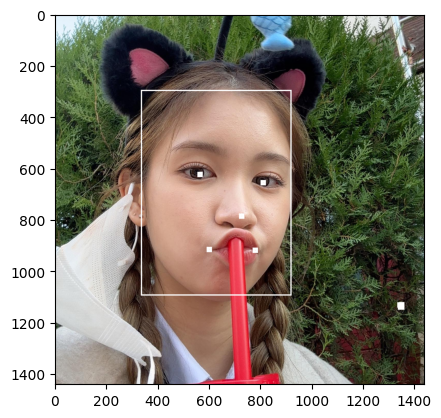

Paeyah


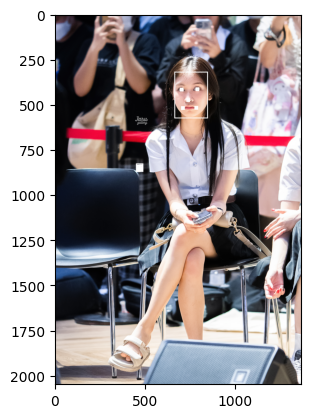

Paeyah


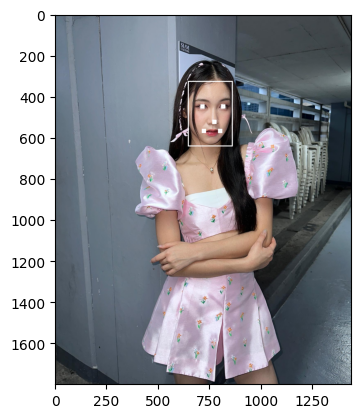

Paeyah


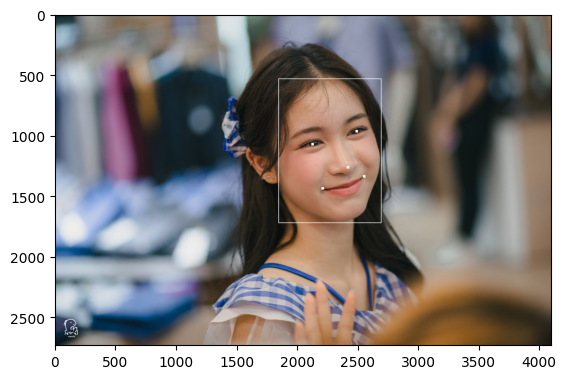

Paeyah


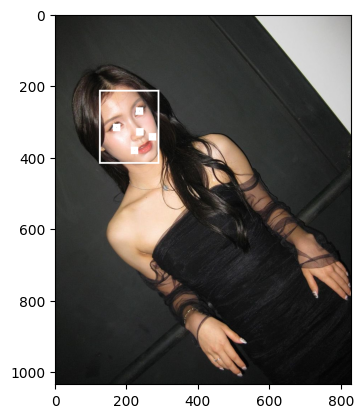

Papang


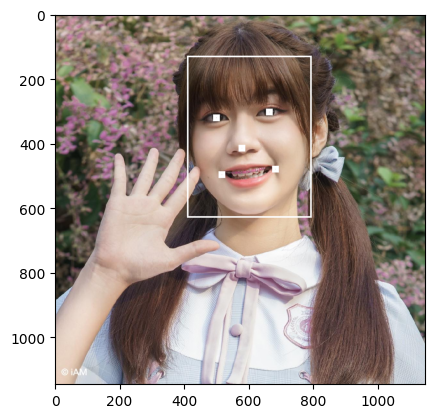

Papang


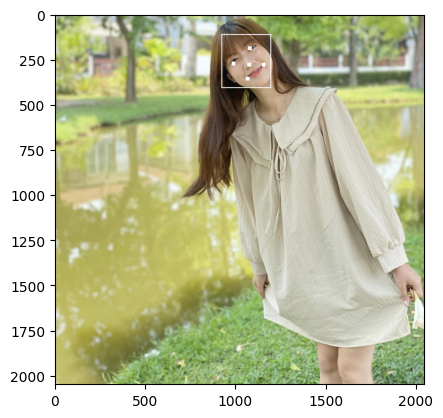

Papang


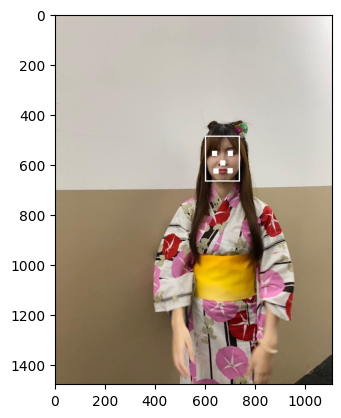

Papang


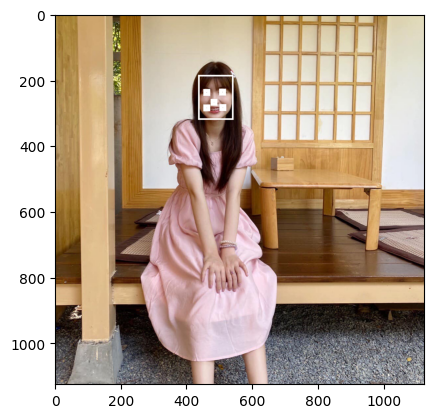

Papang


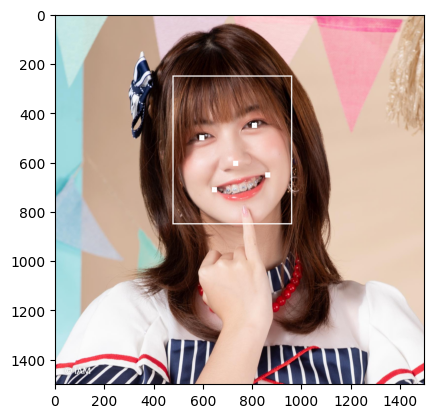

Papang


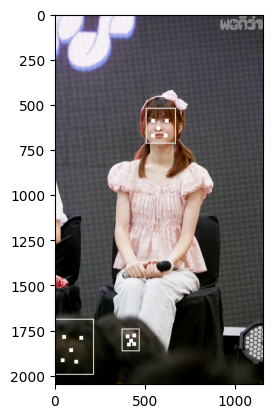

Papang


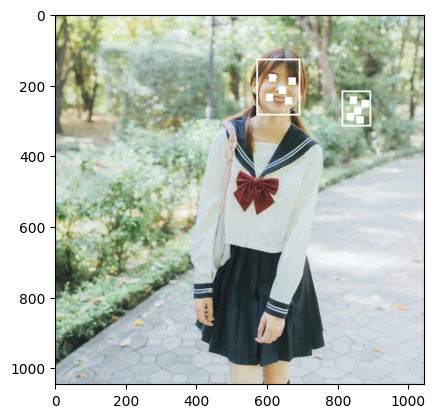

Papang


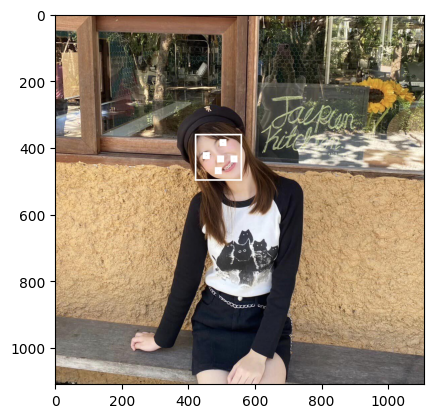

Papang


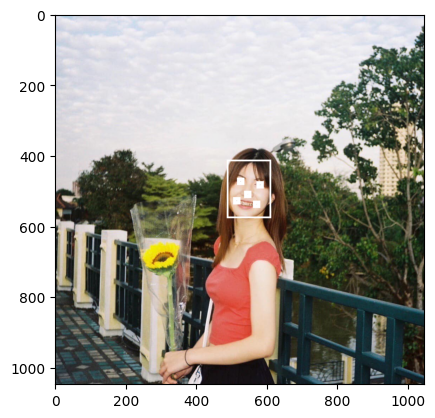

Papang


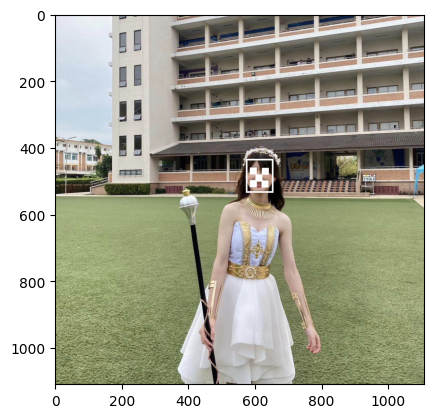

Pin


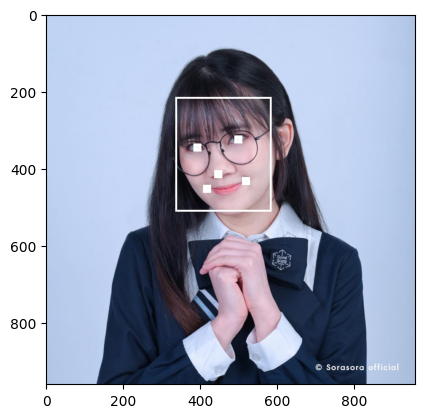

Pin


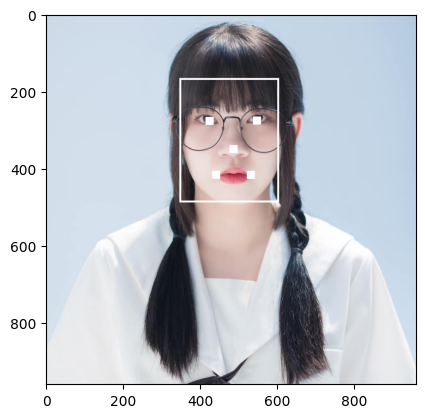

Pin


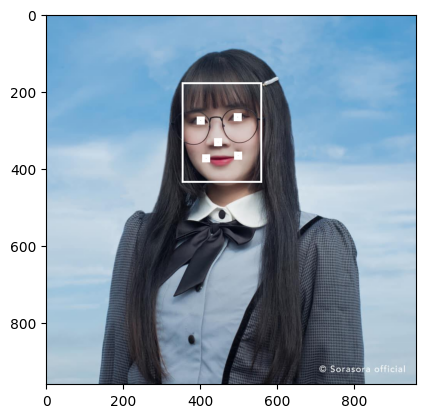

Pin


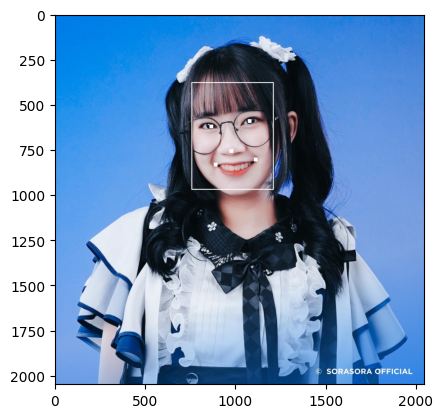

Pin


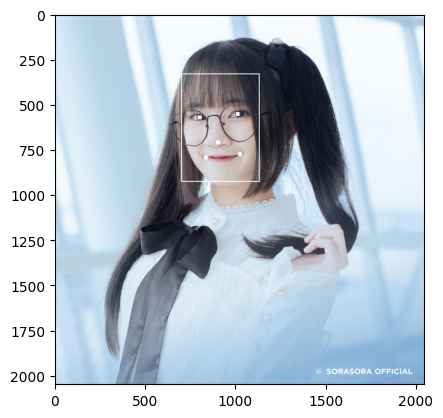

Pin


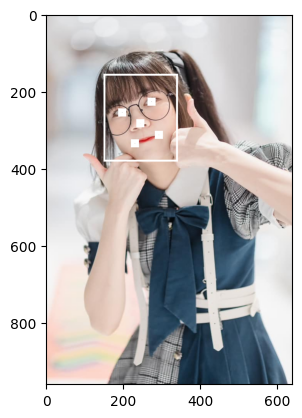

Pin


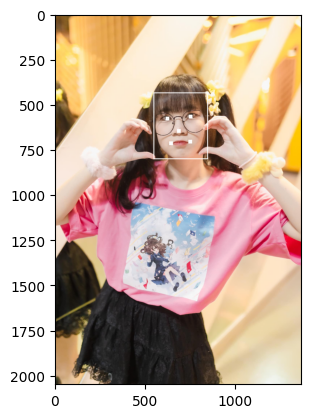

Pin


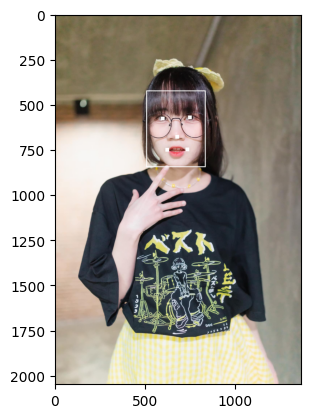

Pin


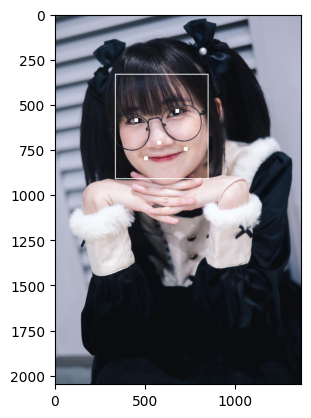

Pin


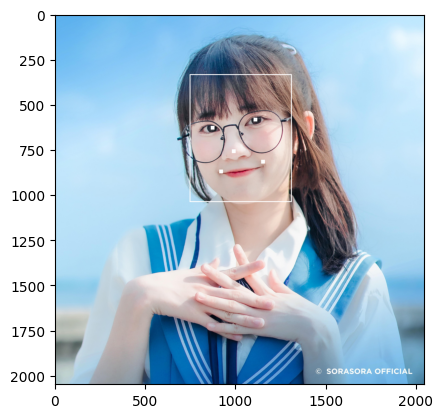

Smild


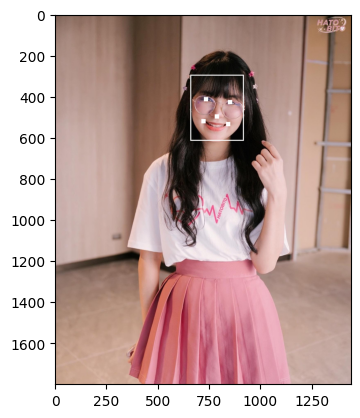

Smild


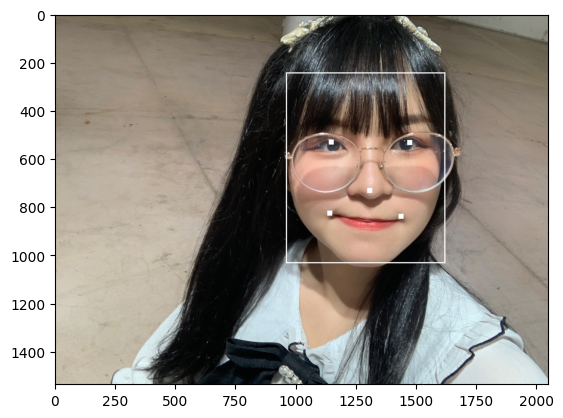

Smild


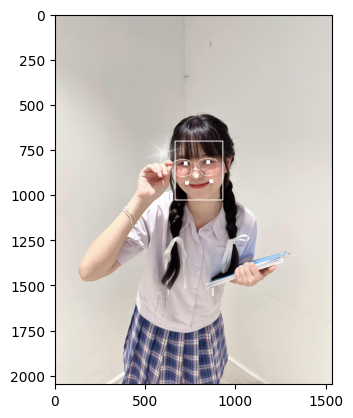

Smild


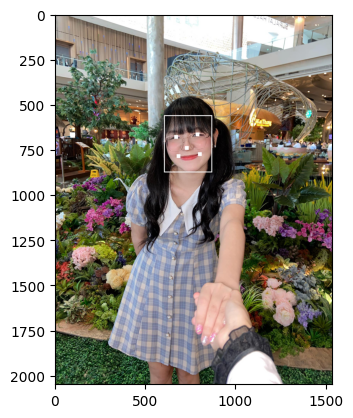

Smild


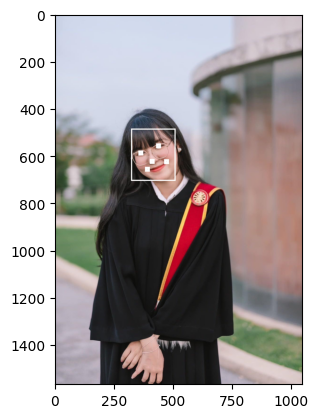

Smild


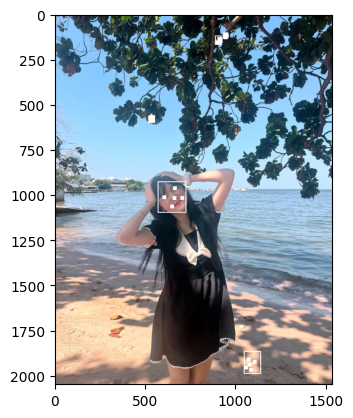

Smild


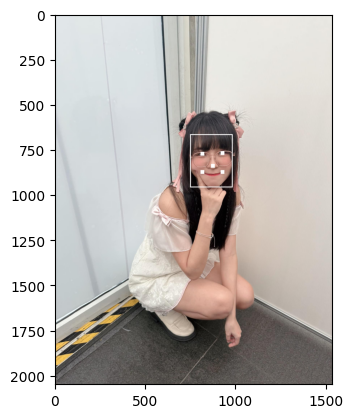

Smild


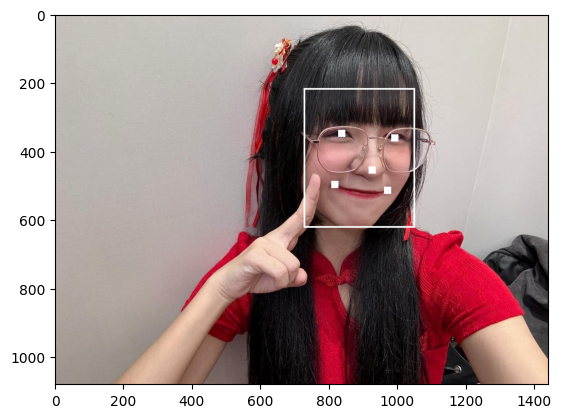

Smild


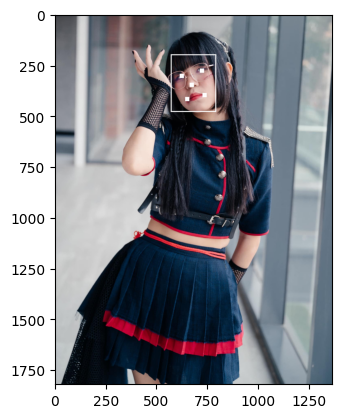

Smild


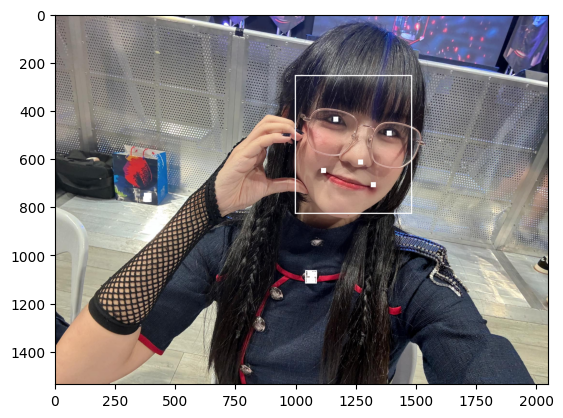

XiuZhen


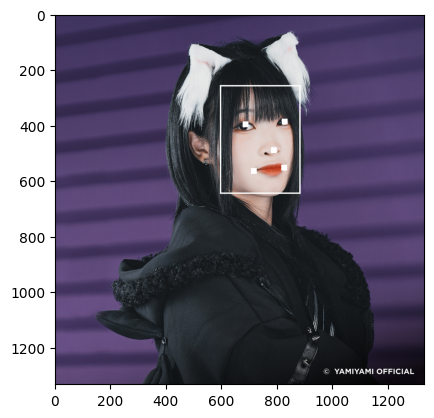

XiuZhen


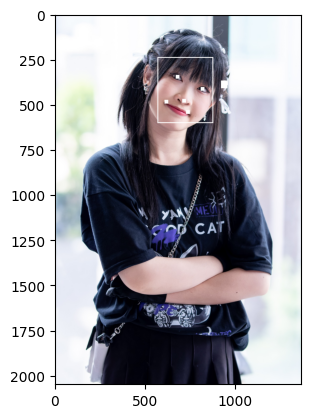

XiuZhen


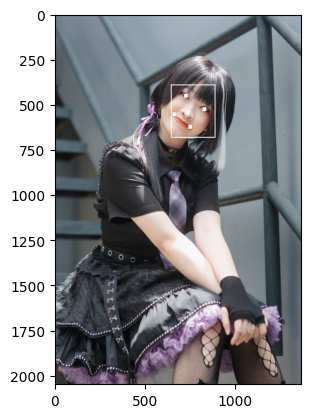

XiuZhen


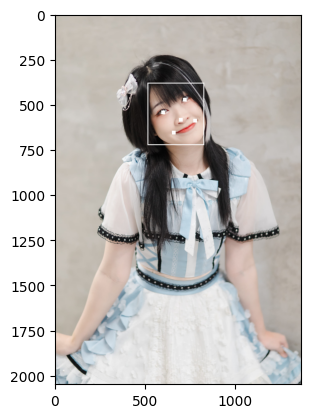

XiuZhen


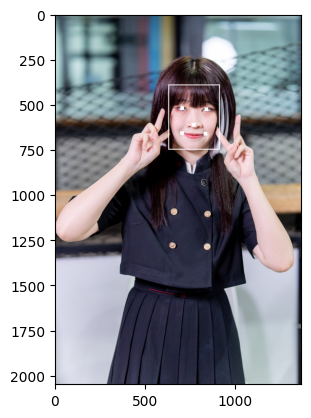

XiuZhen


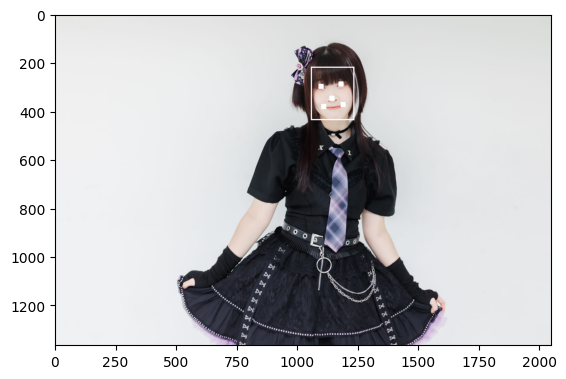

XiuZhen


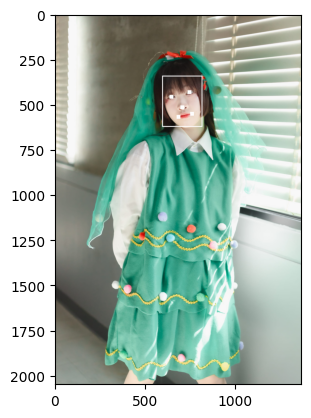

XiuZhen


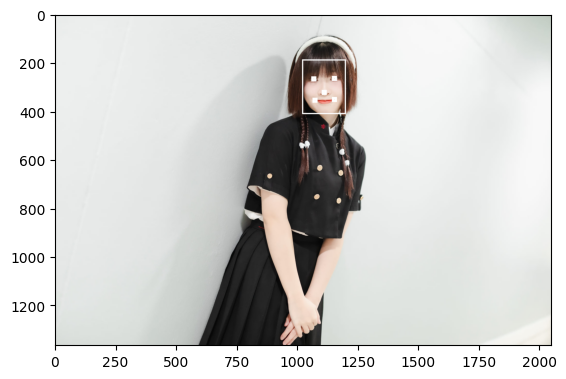

XiuZhen


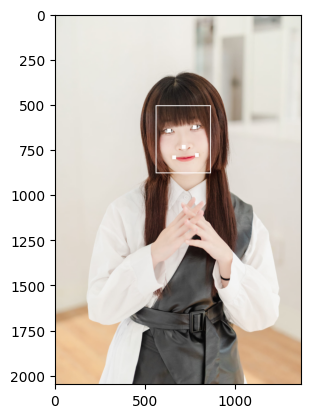

XiuZhen


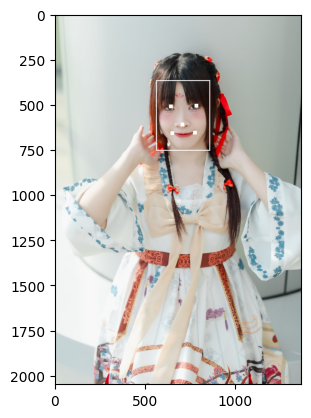

Yayee


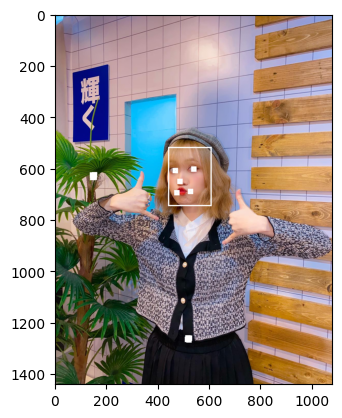

Yayee


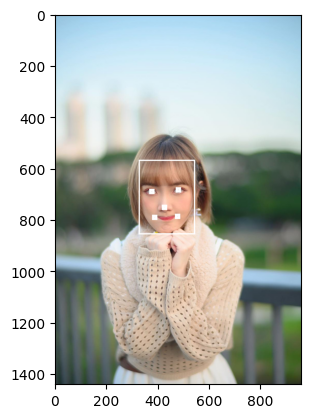

Yayee


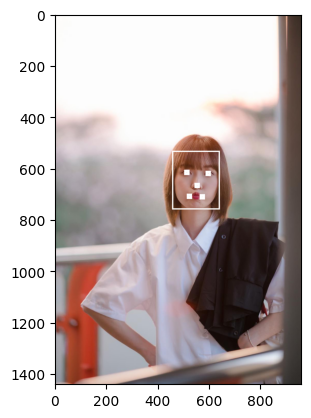

Yayee


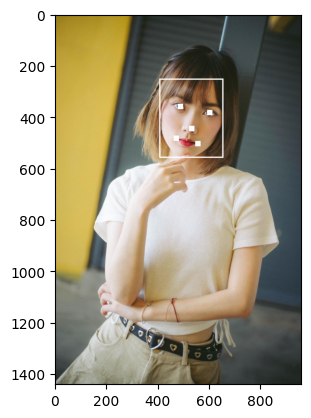

Yayee


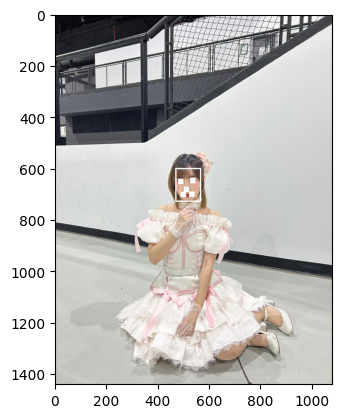

Yayee


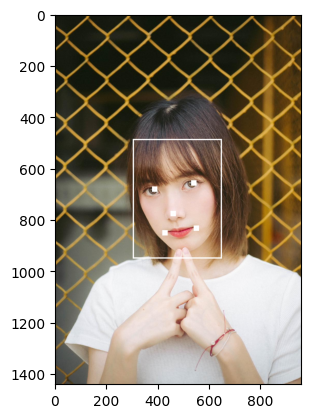

Yayee


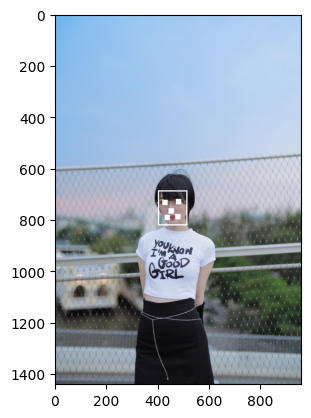

Yayee


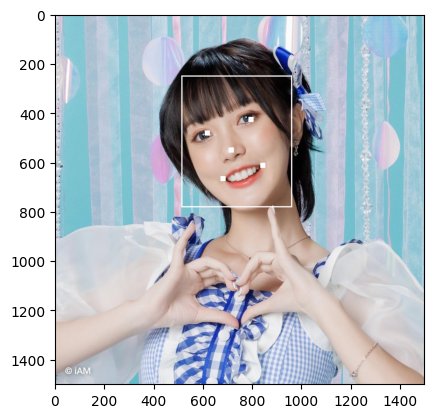

Yayee


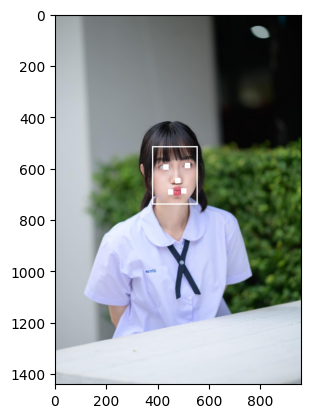

Yayee


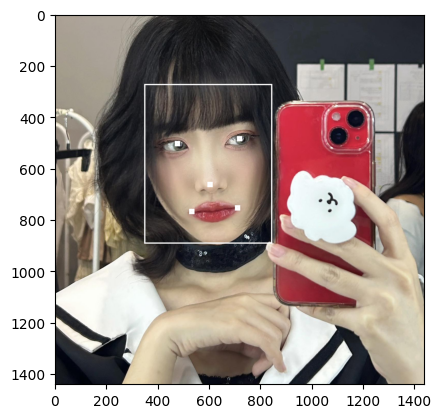

Yoghurt


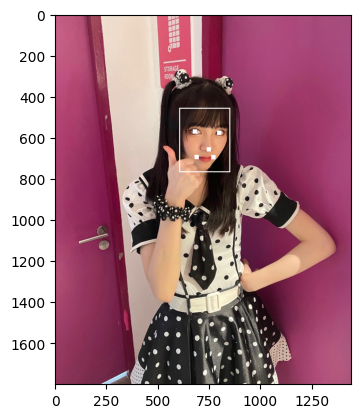

Yoghurt


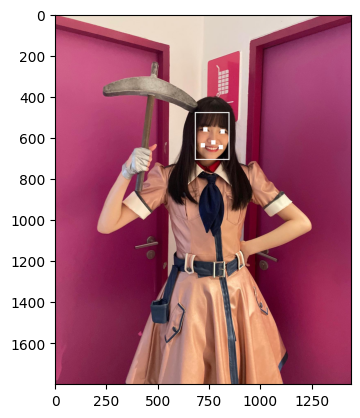

Yoghurt


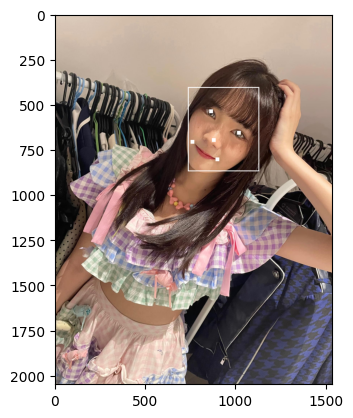

Yoghurt


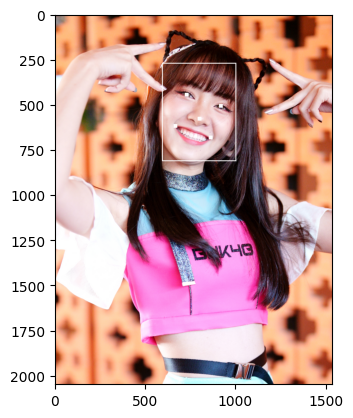

Yoghurt


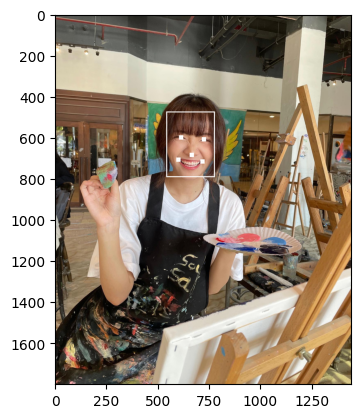

Yoghurt


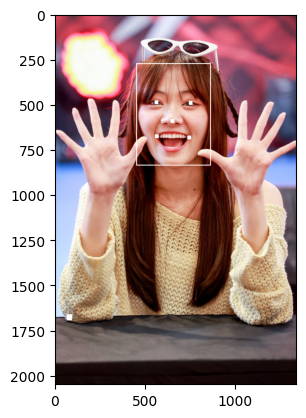

Yoghurt


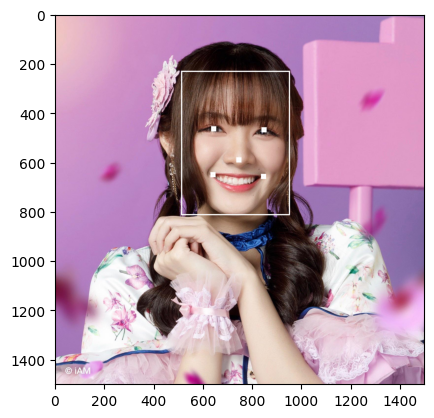

Yoghurt


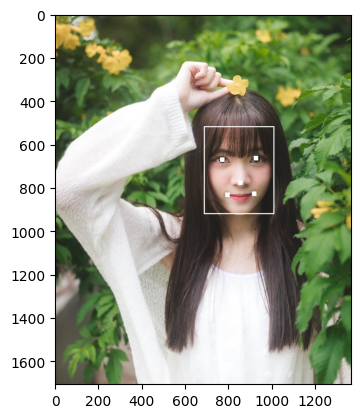

Yoghurt


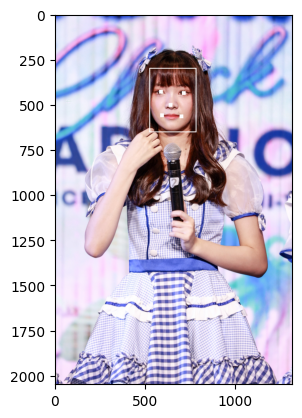

Yoghurt


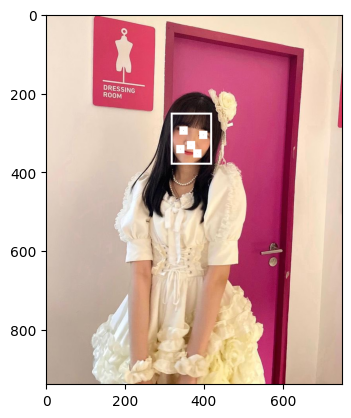

Yuu


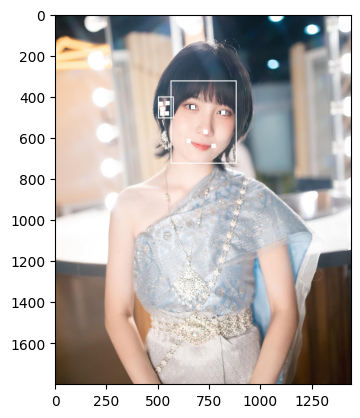

Yuu


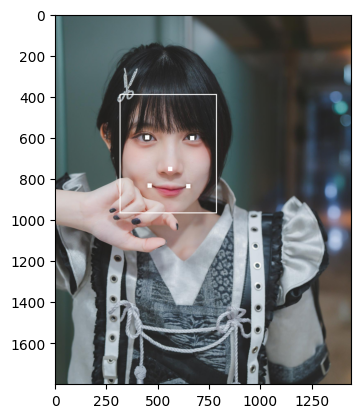

Yuu


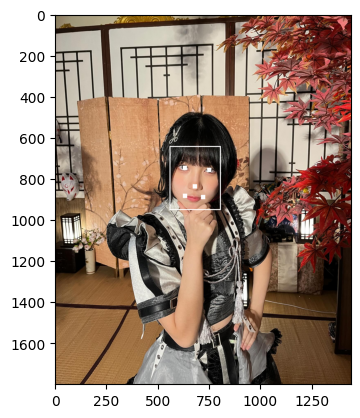

Yuu


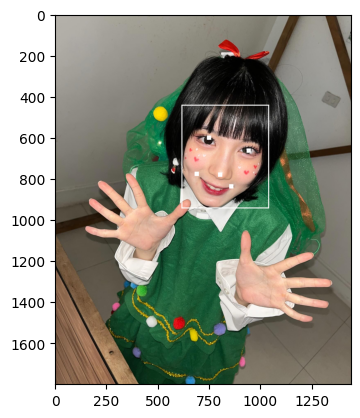

Yuu


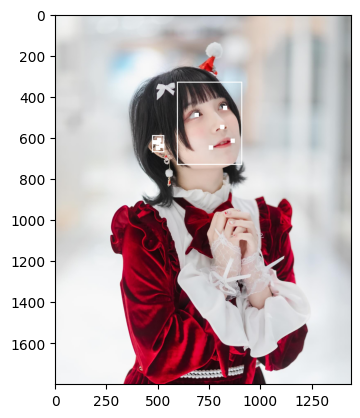

Yuu


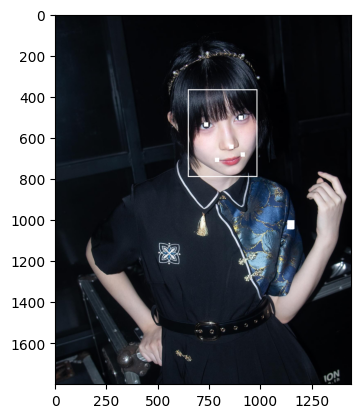

Yuu


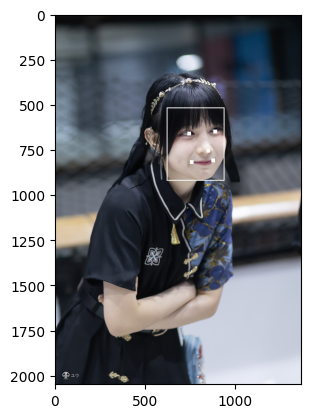

Yuu


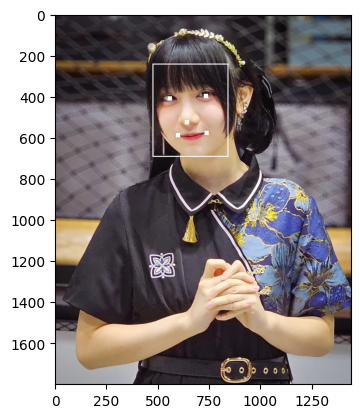

Yuu


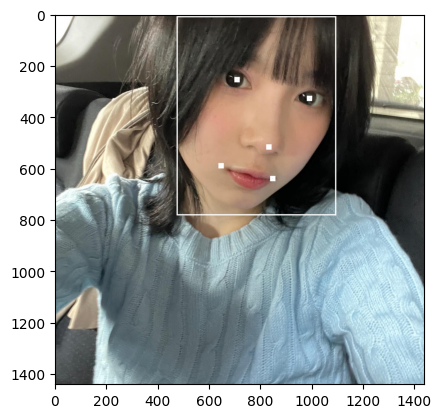

Yuu


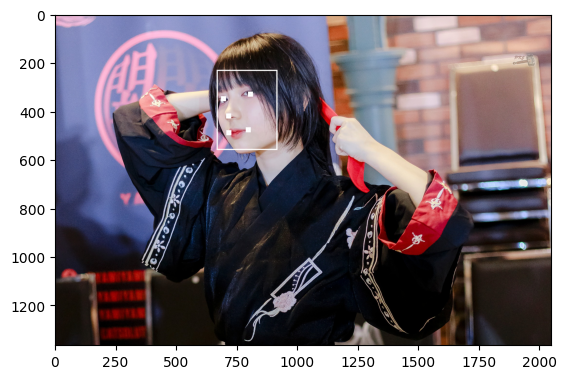

In [ ]:
from PIL import Image, ImageDraw
from facenet_pytorch import MTCNN, extract_face
import matplotlib.pyplot as plt

for x, y in loader:
  print(dataset.idx_to_class[y])
  mtcnn_draw = MTCNN(keep_all=True)
  boxes, probs, points = mtcnn_draw.detect(x, landmarks=True)
  # Draw boxes and save faces
  img_draw = x.copy()
  draw = ImageDraw.Draw(img_draw)
  for i, (box, point) in enumerate(zip(boxes, points)):
    draw.rectangle(box.tolist(), width=5)
    for p in point:
      draw.rectangle((p - 10).tolist() + (p + 10).tolist(), width=10)
    extract_face(x, box, save_path='detected_face_{}.png'.format(i))
  plt.imshow(img_draw)
  plt.show()
  img_draw.save('annotated_faces.png')

<h4>Calculate image embeddings</h4>

In [ ]:
embeddings = resnet(aligned).detach().cpu()

<h4>Print distance matrix for classes</h4>

In [ ]:
# สร้าง list ของชื่อที่มีเลขกำกับ
names_with_index = []
count = {}
for name in names:
    if name in count:
        count[name] += 1
    else:
        count[name] = 1
    names_with_index.append(f"{name}{count[name]}")

# แสดง names_with_index
print(names_with_index)


['Emmy1', 'Emmy2', 'Emmy3', 'Emmy4', 'Emmy5', 'Emmy6', 'Emmy7', 'Emmy8', 'Emmy9', 'Emmy10', 'Endu1', 'Endu2', 'Endu3', 'Endu4', 'Endu5', 'Endu6', 'Endu7', 'Endu8', 'Endu9', 'Endu10', 'Fond1', 'Fond2', 'Fond3', 'Fond4', 'Fond5', 'Fond6', 'Fond7', 'Fond8', 'Fond9', 'Fond10', 'Ginna1', 'Ginna2', 'Ginna3', 'Ginna4', 'Ginna5', 'Ginna6', 'Ginna7', 'Ginna8', 'Ginna9', 'Ginna10', 'Grace1', 'Grace2', 'Grace3', 'Grace4', 'Grace5', 'Grace6', 'Grace7', 'Grace8', 'Grace9', 'Grace10', 'Gracenae1', 'Gracenae2', 'Gracenae3', 'Gracenae4', 'Gracenae5', 'Gracenae6', 'Gracenae7', 'Gracenae8', 'Gracenae9', 'Gracenae10', 'Jajah1', 'Jajah2', 'Jajah3', 'Jajah4', 'Jajah5', 'Jajah6', 'Jajah7', 'Jajah8', 'Jajah9', 'Jajah10', 'L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'L7', 'L8', 'L9', 'L10', 'Lookked1', 'Lookked2', 'Lookked3', 'Lookked4', 'Lookked5', 'Lookked6', 'Lookked7', 'Lookked8', 'Lookked9', 'Lookked10', 'Mewyu1', 'Mewyu2', 'Mewyu3', 'Mewyu4', 'Mewyu5', 'Mewyu6', 'Mewyu7', 'Mewyu8', 'Mewyu9', 'Mewyu10', 'Micha1',

### Verification

In [ ]:
import pandas as pd
import numpy as np

# สร้าง dictionary ที่มี key เป็นชื่อและ value เป็น list ของ embeddings
name_to_embeddings = {}
for name, embedding in zip(names_with_index, embeddings):
    if name not in name_to_embeddings:
        name_to_embeddings[name] = []
    name_to_embeddings[name].append(embedding)

# สร้าง list ของชื่อที่มีเลขกำกับ 1 และ list ของชื่อที่มีเลขกำกับที่มากกว่า 1
names_1 = [name for name in name_to_embeddings.keys() if name.endswith('1')]
names_2_plus = [name for name in name_to_embeddings.keys() if not name.endswith('1')]

# สร้าง list ของ dictionary สำหรับ DataFrame
data = []

# คำนวณระยะห่างระหว่าง embeddings และเพิ่มข้อมูลลงใน list
count = 0
for name1 in names_1:
    count+=1
    for e2 in name_to_embeddings[name1]:
        for name2 in names_2_plus:
            for e1 in name_to_embeddings[name2]:
                distance = (e1 - e2).norm().item()
                data.append({'Sample_ID': count, 'Claimed identity': name1, 'Actual identity': name2, 'distance': distance})

# แปลง list ของ dictionary เป็น DataFrame
df = pd.DataFrame(data)

In [ ]:
df

,Sample_ID,Claimed identity,Actual identity,distance
0,1,Emmy1,Emmy2,1.072759
1,1,Emmy1,Emmy3,0.814468
2,1,Emmy1,Emmy4,0.876285
3,1,Emmy1,Emmy5,0.641193
4,1,Emmy1,Emmy6,0.685371
...,...,...,...,...
3595,20,Yuu1,Yuu6,0.608911
3596,20,Yuu1,Yuu7,0.659632
3597,20,Yuu1,Yuu8,0.707844
3598,20,Yuu1,Yuu9,0.735264


In [ ]:
df["distance"].max()

1.4472534656524658

In [ ]:
# หาจำนวนของ test samples สำหรับแต่ละ user
num_test_samples = df['Claimed identity'].value_counts()

# test samples ทั้งหมด
total_test_samples = sum(df['Claimed identity'].value_counts())
num_test_samples = num_test_samples.append(pd.Series(total_test_samples, index=['Total']))

pd.DataFrame(num_test_samples)

<ipython-input-15-74b4606443b7>:6: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  num_test_samples = num_test_samples.append(pd.Series(total_test_samples, index=['Total']))


,0
Emmy1,180
Endu1,180
Fond1,180
Ginna1,180
Grace1,180
Gracenae1,180
Jajah1,180
L1,180
Lookked1,180
Mewyu1,180


In [ ]:
# ใช้ฟังก์ชัน exponential ในการคำนวณ score จาก distance
def calculate_score(distance, alpha=1.0):
    return np.exp(-alpha * distance)

# คำนวณ score จาก distance
score = df['distance'].apply(calculate_score)

# ใช้ percentile ที่ 95 เป็น threshold
threshold = np.percentile(score, 95)

thresholds = score.sort_values(ascending=True)
thresholds = thresholds.reset_index(drop=True)

# เปลี่ยนชื่อ column จาก 'distance' เป็น 'threshold'
thresholds.name = 'threshold'

pd.DataFrame(thresholds)

,threshold
0,0.235215
1,0.235783
2,0.237914
3,0.238300
4,0.239226
...,...
3595,0.591214
3596,0.618572
3597,0.622305
3598,0.624943


In [ ]:
# คำนวณ FAR และ FRR
FARs = []
FRRs = []
thresholdstodf = []
for threshold in np.arange(df["distance"].min(),df["distance"].max(),0.01):

    thresholdstodf.append(threshold)
    # False Acceptance Rate: ความน่าจะเป็นที่จะยอมรับข้อความที่ไม่ถูกต้อง
    FAR = np.sum((df['Claimed identity'].str.replace(r'\d+', '') != df['Actual identity'].str.replace(r'\d+', '')) & (df['distance'] <= threshold)) / np.sum(df['Claimed identity'].str.replace(r'\d+', '') != df['Actual identity'].str.replace(r'\d+', ''))
    FARs.append(FAR)

    # False Rejection Rate: ความน่าจะเป็นที่จะปฏิเสธข้อความที่ถูกต้อง
    FRR = np.sum((df['Claimed identity'].str.replace(r'\d+', '') == df['Actual identity'].str.replace(r'\d+', '')) & (df['distance'] > threshold)) / np.sum(df['Claimed identity'].str.replace(r'\d+', '') == df['Actual identity'].str.replace(r'\d+', ''))
    FRRs.append(FRR)

# สร้าง DataFrame ของ FAR และ FRR
far_frr_df = pd.DataFrame({'Threshold': thresholdstodf, 'FAR': FARs, 'FRR': FRRs})


<ipython-input-17-3035baa7acdf>:9: FutureWarning: The default value of regex will change from True to False in a future version.
  FAR = np.sum((df['Claimed identity'].str.replace(r'\d+', '') != df['Actual identity'].str.replace(r'\d+', '')) & (df['distance'] <= threshold)) / np.sum(df['Claimed identity'].str.replace(r'\d+', '') != df['Actual identity'].str.replace(r'\d+', ''))
<ipython-input-17-3035baa7acdf>:13: FutureWarning: The default value of regex will change from True to False in a future version.
  FRR = np.sum((df['Claimed identity'].str.replace(r'\d+', '') == df['Actual identity'].str.replace(r'\d+', '')) & (df['distance'] > threshold)) / np.sum(df['Claimed identity'].str.replace(r'\d+', '') == df['Actual identity'].str.replace(r'\d+', ''))


In [ ]:
far_frr_df

,Threshold,FAR,FRR
0,0.454678,0.000000,0.994444
1,0.464678,0.000000,0.994444
2,0.474678,0.000292,0.988889
3,0.484678,0.000292,0.983333
4,0.494678,0.000292,0.983333
...,...,...,...
95,1.404678,0.996491,0.000000
96,1.414678,0.997368,0.000000
97,1.424678,0.998246,0.000000
98,1.434678,0.999123,0.000000


<Axes: >

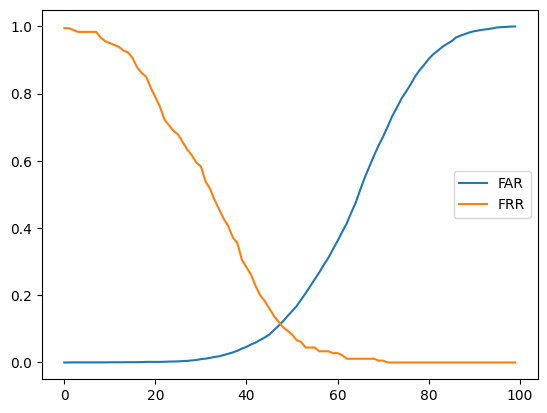

In [ ]:
far_frr_df[['FAR','FRR']].plot()

In [ ]:
# คำนวณ EER
eer_threshold = far_frr_df.iloc[(far_frr_df['FAR'] - far_frr_df['FRR']).abs().idxmin()]['Threshold']
eer = (far_frr_df.iloc[(far_frr_df['FAR'] - far_frr_df['FRR']).abs().idxmin()]['FAR'] + far_frr_df.iloc[(far_frr_df['FAR'] - far_frr_df['FRR']).abs().idxmin()]['FRR']) / 2

eer_threshold, eer

(0.9246784758567814, 0.11535087719298245)

In [ ]:
# สร้าง list ของ dictionary ที่มีข้อมูล FAR และ FRR ของแต่ละ user
user_far_frr_data = [{'User': user,
                      'FAR': np.sum((df['Claimed identity'].str.replace(r'\d+', '') != user) & (df['distance'] >= eer_threshold)) / np.sum(df['Claimed identity'].str.replace(r'\d+', '') != user),
                      'FRR': np.sum((df['Claimed identity'].str.replace(r'\d+', '') == user) & (df['distance'] < eer_threshold)) / np.sum(df['Claimed identity'].str.replace(r'\d+', '') == user)}
                     for user in df['Actual identity'].str.replace(r'\d+', '').unique()]

# สร้าง DataFrame จาก list ของ dictionary
user_far_frr_df = pd.DataFrame(user_far_frr_data)

<ipython-input-21-f4f1634202a6>:5: FutureWarning: The default value of regex will change from True to False in a future version.
  for user in df['Actual identity'].str.replace(r'\d+', '').unique()]
<ipython-input-21-f4f1634202a6>:3: FutureWarning: The default value of regex will change from True to False in a future version.
  'FAR': np.sum((df['Claimed identity'].str.replace(r'\d+', '') != user) & (df['distance'] >= eer_threshold)) / np.sum(df['Claimed identity'].str.replace(r'\d+', '') != user),
<ipython-input-21-f4f1634202a6>:4: FutureWarning: The default value of regex will change from True to False in a future version.
  'FRR': np.sum((df['Claimed identity'].str.replace(r'\d+', '') == user) & (df['distance'] < eer_threshold)) / np.sum(df['Claimed identity'].str.replace(r'\d+', '') == user)}


In [ ]:
user_far_frr_df

,User,FAR,FRR
0,Emmy,0.857310,0.227778
1,Endu,0.856140,0.205556
2,Fond,0.849123,0.072222
3,Ginna,0.848246,0.055556
4,Grace,0.854386,0.172222
5,Gracenae,0.855263,0.188889
6,Jajah,0.847953,0.050000
7,L,0.848246,0.055556
8,Lookked,0.854386,0.172222
9,Mewyu,0.848246,0.055556


<Axes: xlabel='User'>

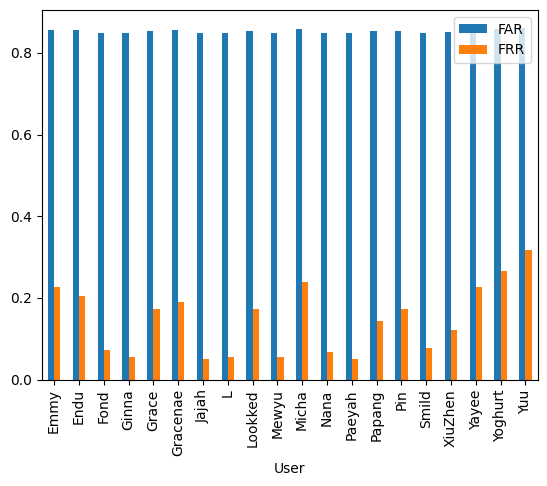

In [ ]:
user_far_frr_df.plot(kind='bar', x='User')

### Identification

In [ ]:
import pandas as pd

# สร้าง dictionary ที่มี key เป็นชื่อและ value เป็น list ของ embeddings
name_to_embeddings = {}
for name, embedding in zip(names_with_index, embeddings):
    if name not in name_to_embeddings:
        name_to_embeddings[name] = []
    name_to_embeddings[name].append(embedding)

# สร้าง list ของชื่อที่มีเลขกำกับ 1 และ list ของชื่อที่มีเลขกำกับที่มากกว่า 1
names_1 = [name for name in name_to_embeddings.keys() if name.endswith('1')]
names_2_plus = [name for name in name_to_embeddings.keys() if not name.endswith('1')]

# คำนวณระยะห่างระหว่าง embeddings
dists = [[(e1 - e2).norm().item() for name1 in names_1 for e2 in name_to_embeddings[name1]] for name2 in names_2_plus for e1 in name_to_embeddings[name2]]

# สร้าง DataFrame
df = pd.DataFrame(dists, columns=names_1, index=names_2_plus)
df

,Emmy1,Endu1,Fond1,Ginna1,Grace1,Gracenae1,Jajah1,L1,Lookked1,Mewyu1,Micha1,Nana1,Paeyah1,Papang1,Pin1,Smild1,XiuZhen1,Yayee1,Yoghurt1,Yuu1
Emmy2,1.072759,1.041152,1.218876,1.147157,1.014410,1.209663,1.176905,1.201108,1.117453,1.240507,1.171479,0.954127,1.142943,1.220235,1.164168,1.001307,1.298338,1.301354,1.306229,1.122752
Emmy3,0.814468,0.940081,1.187173,1.224582,0.936546,1.132356,1.125270,1.078274,0.985612,1.236005,1.139858,1.085191,1.129014,1.063294,1.138469,1.070425,1.033377,1.006521,1.204174,0.978607
Emmy4,0.876285,0.840841,1.117673,1.238522,0.988977,1.048445,1.072691,1.197640,1.102288,1.330763,1.112154,0.984911,1.146289,1.124335,1.106065,1.055114,1.037635,1.015022,1.120748,0.942362
Emmy5,0.641193,0.927761,1.191906,1.309746,1.141402,0.930412,1.216761,1.121549,1.091720,1.401425,1.106015,1.286332,1.171989,1.144252,1.044239,1.276058,0.758556,0.759825,0.913585,0.826255
Emmy6,0.685371,0.858963,1.130794,1.225039,1.059263,0.998299,1.192520,1.166165,1.109110,1.296063,1.132912,1.163841,1.118970,1.100161,1.061052,1.111899,0.839455,0.976435,1.080363,0.856842
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Yuu6,0.885126,0.849122,0.919110,1.134725,1.172433,0.750725,1.165800,1.054054,1.104364,1.334164,0.776947,1.147523,1.183937,0.904963,0.926609,1.236876,1.064882,0.895137,0.787334,0.608911
Yuu7,0.912653,0.921191,0.986941,1.103539,1.046054,0.984551,1.114058,1.002544,1.018416,1.235448,0.943504,1.168961,1.155427,1.011562,1.110452,1.175060,1.105070,1.022524,0.823842,0.659632
Yuu8,1.006031,0.927611,0.994723,1.166328,1.084593,1.037061,1.039942,1.085873,1.133719,1.311860,1.123587,1.213318,1.115371,0.994082,1.018257,1.141669,1.199062,1.005754,0.876464,0.707844
Yuu9,0.908786,0.904211,0.929440,1.127337,1.101582,0.860726,1.186449,1.118424,1.110014,1.341912,0.834082,1.063335,1.179706,1.051699,0.967548,1.198800,1.068317,0.928563,0.872353,0.735264


In [ ]:
# สร้าง close set
close_set_names = names_1
close_set_row = names_2_plus
close_set_df = df.loc[close_set_row,close_set_names]

# สร้าง open set
open_set_df = df.loc[:,close_set_names[:10]]
close_set_df

,Emmy1,Endu1,Fond1,Ginna1,Grace1,Gracenae1,Jajah1,L1,Lookked1,Mewyu1,Micha1,Nana1,Paeyah1,Papang1,Pin1,Smild1,XiuZhen1,Yayee1,Yoghurt1,Yuu1
Emmy2,1.072759,1.041152,1.218876,1.147157,1.014410,1.209663,1.176905,1.201108,1.117453,1.240507,1.171479,0.954127,1.142943,1.220235,1.164168,1.001307,1.298338,1.301354,1.306229,1.122752
Emmy3,0.814468,0.940081,1.187173,1.224582,0.936546,1.132356,1.125270,1.078274,0.985612,1.236005,1.139858,1.085191,1.129014,1.063294,1.138469,1.070425,1.033377,1.006521,1.204174,0.978607
Emmy4,0.876285,0.840841,1.117673,1.238522,0.988977,1.048445,1.072691,1.197640,1.102288,1.330763,1.112154,0.984911,1.146289,1.124335,1.106065,1.055114,1.037635,1.015022,1.120748,0.942362
Emmy5,0.641193,0.927761,1.191906,1.309746,1.141402,0.930412,1.216761,1.121549,1.091720,1.401425,1.106015,1.286332,1.171989,1.144252,1.044239,1.276058,0.758556,0.759825,0.913585,0.826255
Emmy6,0.685371,0.858963,1.130794,1.225039,1.059263,0.998299,1.192520,1.166165,1.109110,1.296063,1.132912,1.163841,1.118970,1.100161,1.061052,1.111899,0.839455,0.976435,1.080363,0.856842
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Yuu6,0.885126,0.849122,0.919110,1.134725,1.172433,0.750725,1.165800,1.054054,1.104364,1.334164,0.776947,1.147523,1.183937,0.904963,0.926609,1.236876,1.064882,0.895137,0.787334,0.608911
Yuu7,0.912653,0.921191,0.986941,1.103539,1.046054,0.984551,1.114058,1.002544,1.018416,1.235448,0.943504,1.168961,1.155427,1.011562,1.110452,1.175060,1.105070,1.022524,0.823842,0.659632
Yuu8,1.006031,0.927611,0.994723,1.166328,1.084593,1.037061,1.039942,1.085873,1.133719,1.311860,1.123587,1.213318,1.115371,0.994082,1.018257,1.141669,1.199062,1.005754,0.876464,0.707844
Yuu9,0.908786,0.904211,0.929440,1.127337,1.101582,0.860726,1.186449,1.118424,1.110014,1.341912,0.834082,1.063335,1.179706,1.051699,0.967548,1.198800,1.068317,0.928563,0.872353,0.735264


##### Close set

In [ ]:
# 1. Close set identification
# Number of probes
num_probes_close = len(close_set_df)
num_probes_close

180

In [ ]:
# Number of probes for each user
names_without_numbers = close_set_df.index.str.replace(r'\d+$', '')
num_probes_per_user_close = names_without_numbers.value_counts()

pd.DataFrame(num_probes_per_user_close)

<ipython-input-26-e8d455605b0c>:2: FutureWarning: The default value of regex will change from True to False in a future version.
  names_without_numbers = close_set_df.index.str.replace(r'\d+$', '')


,0
Emmy,9
Endu,9
Yoghurt,9
Yayee,9
XiuZhen,9
Smild,9
Pin,9
Papang,9
Paeyah,9
Nana,9


In [ ]:
# Number of templates
num_templates_close = len(close_set_df.columns)
num_templates_close

20

In [ ]:
# สร้าง DataFrame ใหม่จาก close_set_df
close_set_Rank_test = close_set_df.copy()

# เพิ่มการทดลอง identify เป็นคอลัมน์ใน close_set_Rank_test
close_set_Rank_test['Rank_1_Identify'] = close_set_df.apply(lambda x: x.astype(float).nsmallest(3).index[0], axis=1)
close_set_Rank_test['Rank_2_Identify'] = close_set_df.apply(lambda x: x.astype(float).nsmallest(3).index[1], axis=1)
close_set_Rank_test['Rank_3_Identify'] = close_set_df.apply(lambda x: x.astype(float).nsmallest(3).index[2], axis=1)

close_set_Rank_test

,Emmy1,Endu1,Fond1,Ginna1,Grace1,Gracenae1,Jajah1,L1,Lookked1,Mewyu1,...,Papang1,Pin1,Smild1,XiuZhen1,Yayee1,Yoghurt1,Yuu1,Rank_1_Identify,Rank_2_Identify,Rank_3_Identify
Emmy2,1.072759,1.041152,1.218876,1.147157,1.014410,1.209663,1.176905,1.201108,1.117453,1.240507,...,1.220235,1.164168,1.001307,1.298338,1.301354,1.306229,1.122752,Nana1,Smild1,Grace1
Emmy3,0.814468,0.940081,1.187173,1.224582,0.936546,1.132356,1.125270,1.078274,0.985612,1.236005,...,1.063294,1.138469,1.070425,1.033377,1.006521,1.204174,0.978607,Emmy1,Grace1,Endu1
Emmy4,0.876285,0.840841,1.117673,1.238522,0.988977,1.048445,1.072691,1.197640,1.102288,1.330763,...,1.124335,1.106065,1.055114,1.037635,1.015022,1.120748,0.942362,Endu1,Emmy1,Yuu1
Emmy5,0.641193,0.927761,1.191906,1.309746,1.141402,0.930412,1.216761,1.121549,1.091720,1.401425,...,1.144252,1.044239,1.276058,0.758556,0.759825,0.913585,0.826255,Emmy1,XiuZhen1,Yayee1
Emmy6,0.685371,0.858963,1.130794,1.225039,1.059263,0.998299,1.192520,1.166165,1.109110,1.296063,...,1.100161,1.061052,1.111899,0.839455,0.976435,1.080363,0.856842,Emmy1,XiuZhen1,Yuu1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Yuu6,0.885126,0.849122,0.919110,1.134725,1.172433,0.750725,1.165800,1.054054,1.104364,1.334164,...,0.904963,0.926609,1.236876,1.064882,0.895137,0.787334,0.608911,Yuu1,Gracenae1,Micha1
Yuu7,0.912653,0.921191,0.986941,1.103539,1.046054,0.984551,1.114058,1.002544,1.018416,1.235448,...,1.011562,1.110452,1.175060,1.105070,1.022524,0.823842,0.659632,Yuu1,Yoghurt1,Emmy1
Yuu8,1.006031,0.927611,0.994723,1.166328,1.084593,1.037061,1.039942,1.085873,1.133719,1.311860,...,0.994082,1.018257,1.141669,1.199062,1.005754,0.876464,0.707844,Yuu1,Yoghurt1,Endu1
Yuu9,0.908786,0.904211,0.929440,1.127337,1.101582,0.860726,1.186449,1.118424,1.110014,1.341912,...,1.051699,0.967548,1.198800,1.068317,0.928563,0.872353,0.735264,Yuu1,Micha1,Gracenae1


In [ ]:
# สร้างฟังก์ชันเพื่อตรวจสอบว่าค่าที่ถูกต้องอยู่ในอันดับที่ 1, 2 หรือ 3 หรือไม่
def check_rank(row):
    index_stripped = row.name.rstrip('1234567890')
    return (row['Rank_1_Identify'].rstrip('1234567890') == index_stripped,
            row['Rank_2_Identify'].rstrip('1234567890') == index_stripped,
            row['Rank_3_Identify'].rstrip('1234567890') == index_stripped)

# ใช้ฟังก์ชัน check_rank กับ DataFrame
ranks = close_set_Rank_test.apply(check_rank, axis=1, result_type='expand')

In [ ]:
ranks

,0,1,2
Emmy2,False,False,False
Emmy3,True,False,False
Emmy4,False,True,False
Emmy5,True,False,False
Emmy6,True,False,False
...,...,...,...
Yuu6,True,False,False
Yuu7,True,False,False
Yuu8,True,False,False
Yuu9,True,False,False


In [ ]:
# คำนวณความแม่นยำของ Rank-1, Rank-2 และ Rank-3
rank_1_accuracy = ranks[0].mean()
rank_2_accuracy = ranks[[0, 1]].any(axis=1).mean()
rank_3_accuracy = ranks.any(axis=1).mean()

rank_1_accuracy, rank_2_accuracy, rank_3_accuracy

(0.7222222222222222, 0.8222222222222222, 0.9)

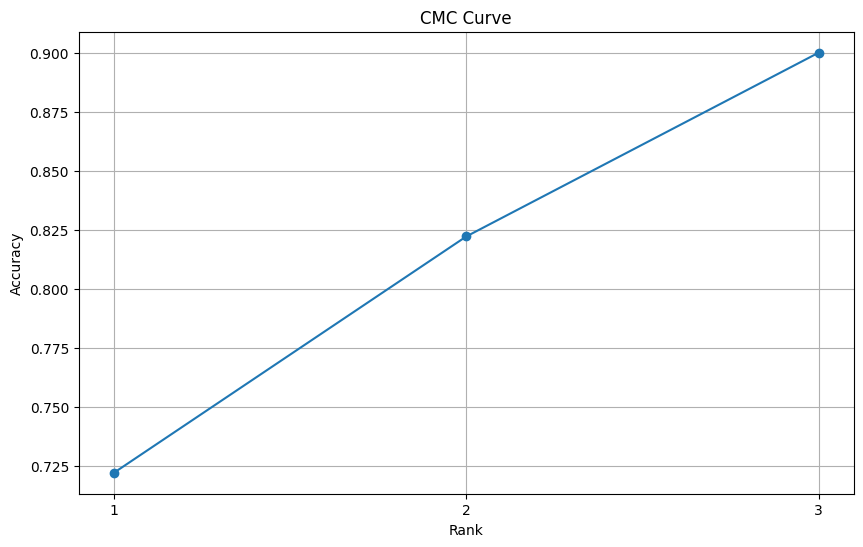

In [ ]:
import matplotlib.pyplot as plt

# ความแม่นยำของ Rank-1, Rank-2 และ Rank-3 ที่คุณได้จากการคำนวณ
accuracies = [rank_1_accuracy, rank_2_accuracy, rank_3_accuracy]

# สร้าง CMC curve
plt.figure(figsize=(10, 6))
plt.plot(range(1, 4), accuracies, marker='o')
plt.xticks(range(1, 4))
plt.xlabel('Rank')
plt.ylabel('Accuracy')
plt.title('CMC Curve')
plt.grid(True)
plt.show()


#### Open set

In [ ]:
open_set_df

,Emmy1,Endu1,Fond1,Ginna1,Grace1,Gracenae1,Jajah1,L1,Lookked1,Mewyu1
Emmy2,1.072759,1.041152,1.218876,1.147157,1.014410,1.209663,1.176905,1.201108,1.117453,1.240507
Emmy3,0.814468,0.940081,1.187173,1.224582,0.936546,1.132356,1.125270,1.078274,0.985612,1.236005
Emmy4,0.876285,0.840841,1.117673,1.238522,0.988977,1.048445,1.072691,1.197640,1.102288,1.330763
Emmy5,0.641193,0.927761,1.191906,1.309746,1.141402,0.930412,1.216761,1.121549,1.091720,1.401425
Emmy6,0.685371,0.858963,1.130794,1.225039,1.059263,0.998299,1.192520,1.166165,1.109110,1.296063
...,...,...,...,...,...,...,...,...,...,...
Yuu6,0.885126,0.849122,0.919110,1.134725,1.172433,0.750725,1.165800,1.054054,1.104364,1.334164
Yuu7,0.912653,0.921191,0.986941,1.103539,1.046054,0.984551,1.114058,1.002544,1.018416,1.235448
Yuu8,1.006031,0.927611,0.994723,1.166328,1.084593,1.037061,1.039942,1.085873,1.133719,1.311860
Yuu9,0.908786,0.904211,0.929440,1.127337,1.101582,0.860726,1.186449,1.118424,1.110014,1.341912


In [ ]:
# Number of probes for each user
names_without_numbers = open_set_df.index.str.replace(r'\d+$', '')
num_probes_per_user_open = names_without_numbers.value_counts()

AllMember = pd.DataFrame(num_probes_per_user_open)
AllMember

<ipython-input-34-0bb75fbaad98>:2: FutureWarning: The default value of regex will change from True to False in a future version.
  names_without_numbers = open_set_df.index.str.replace(r'\d+$', '')


,0
Emmy,9
Endu,9
Yoghurt,9
Yayee,9
XiuZhen,9
Smild,9
Pin,9
Papang,9
Paeyah,9
Nana,9


In [ ]:
EnrollMemer = AllMember.iloc[:10]


EnrollMemerCount = len(EnrollMemer)
EnrollMemer

,0
Emmy,9
Endu,9
Yoghurt,9
Yayee,9
XiuZhen,9
Smild,9
Pin,9
Papang,9
Paeyah,9
Nana,9


In [ ]:
UnknownMemer = AllMember.iloc[10:]

UnknownMemerCount = len(UnknownMemer)
UnknownMemer

,0
Micha,9
Mewyu,9
Lookked,9
L,9
Jajah,9
Gracenae,9
Grace,9
Ginna,9
Fond,9
Yuu,9


In [ ]:
# Number of templates
num_templates_open = len(open_set_df.columns)
num_templates_open

10

In [ ]:
# คำนวณค่า quantile ที่ 25
qtest = open_set_df.quantile(0.10, axis=1)

# คำนวณค่า quantile ที่ 10, 20, ..., 90
quantiles = [qtest.quantile(i/100) for i in range(10, 100, 5)]

# ใช้ค่า quantile เป็น threshold
thresholds = quantiles

In [ ]:
thresholds

[0.8437931650876999,
 0.8618858659267425,
 0.8803442203998566,
 0.8918671175837516,
 0.9019863253831863,
 0.9162593275308609,
 0.9250813496112824,
 0.9314935204386711,
 0.9426068484783172,
 0.9518830877542496,
 0.9624110794067383,
 0.973141231238842,
 0.9819563543796539,
 0.9912327721714973,
 1.0003025269508363,
 1.0204431837797165,
 1.0423145681619643,
 1.0658355876803396]

In [ ]:
# สร้าง DataFrame ใหม่จาก open_set_df
open_set_Rank_test = open_set_df.copy()

# เพิ่มการทดลอง identify เป็นคอลัมน์ใน open_set_Rank_test
open_set_Rank_test['Rank_1_Identify'] = open_set_df.apply(lambda x: x.astype(float).nsmallest(3).index[0], axis=1)

for t in np.arange(0.5, 1.2, 0.001):
  open_set_Rank_test[f'Rank_1_Threshold {t}'] = open_set_df.apply(lambda x: x.astype(float).nsmallest(3).index[0] if x.astype(float).nsmallest(3)[0] < t else 'reject', axis=1)

open_set_Rank_test

<ipython-input-40-f622b75fc60f>:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  open_set_Rank_test[f'Rank_1_Threshold {t}'] = open_set_df.apply(lambda x: x.astype(float).nsmallest(3).index[0] if x.astype(float).nsmallest(3)[0] < t else 'reject', axis=1)
<ipython-input-40-f622b75fc60f>:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  open_set_Rank_test[f'Rank_1_Threshold {t}'] = open_set_df.apply(lambda x: x.astype(float).nsmallest(3).index[0] if x.astype(float).nsmallest(3)[0] < t else 'reject', axis=1)
<ipython-input-40-f622b7

,Emmy1,Endu1,Fond1,Ginna1,Grace1,Gracenae1,Jajah1,L1,Lookked1,Mewyu1,...,Rank_1_Threshold 1.1900000000000006,Rank_1_Threshold 1.1910000000000007,Rank_1_Threshold 1.1920000000000006,Rank_1_Threshold 1.1930000000000005,Rank_1_Threshold 1.1940000000000006,Rank_1_Threshold 1.1950000000000007,Rank_1_Threshold 1.1960000000000006,Rank_1_Threshold 1.1970000000000005,Rank_1_Threshold 1.1980000000000006,Rank_1_Threshold 1.1990000000000007
Emmy2,1.072759,1.041152,1.218876,1.147157,1.014410,1.209663,1.176905,1.201108,1.117453,1.240507,...,Grace1,Grace1,Grace1,Grace1,Grace1,Grace1,Grace1,Grace1,Grace1,Grace1
Emmy3,0.814468,0.940081,1.187173,1.224582,0.936546,1.132356,1.125270,1.078274,0.985612,1.236005,...,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1
Emmy4,0.876285,0.840841,1.117673,1.238522,0.988977,1.048445,1.072691,1.197640,1.102288,1.330763,...,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1
Emmy5,0.641193,0.927761,1.191906,1.309746,1.141402,0.930412,1.216761,1.121549,1.091720,1.401425,...,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1
Emmy6,0.685371,0.858963,1.130794,1.225039,1.059263,0.998299,1.192520,1.166165,1.109110,1.296063,...,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Yuu6,0.885126,0.849122,0.919110,1.134725,1.172433,0.750725,1.165800,1.054054,1.104364,1.334164,...,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1
Yuu7,0.912653,0.921191,0.986941,1.103539,1.046054,0.984551,1.114058,1.002544,1.018416,1.235448,...,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1
Yuu8,1.006031,0.927611,0.994723,1.166328,1.084593,1.037061,1.039942,1.085873,1.133719,1.311860,...,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1
Yuu9,0.908786,0.904211,0.929440,1.127337,1.101582,0.860726,1.186449,1.118424,1.110014,1.341912,...,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1


In [ ]:
EnrollMemer_rank = open_set_Rank_test.iloc[:10*9]
EnrollMemer_rank

,Emmy1,Endu1,Fond1,Ginna1,Grace1,Gracenae1,Jajah1,L1,Lookked1,Mewyu1,...,Rank_1_Threshold 1.1900000000000006,Rank_1_Threshold 1.1910000000000007,Rank_1_Threshold 1.1920000000000006,Rank_1_Threshold 1.1930000000000005,Rank_1_Threshold 1.1940000000000006,Rank_1_Threshold 1.1950000000000007,Rank_1_Threshold 1.1960000000000006,Rank_1_Threshold 1.1970000000000005,Rank_1_Threshold 1.1980000000000006,Rank_1_Threshold 1.1990000000000007
Emmy2,1.072759,1.041152,1.218876,1.147157,1.014410,1.209663,1.176905,1.201108,1.117453,1.240507,...,Grace1,Grace1,Grace1,Grace1,Grace1,Grace1,Grace1,Grace1,Grace1,Grace1
Emmy3,0.814468,0.940081,1.187173,1.224582,0.936546,1.132356,1.125270,1.078274,0.985612,1.236005,...,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1
Emmy4,0.876285,0.840841,1.117673,1.238522,0.988977,1.048445,1.072691,1.197640,1.102288,1.330763,...,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1
Emmy5,0.641193,0.927761,1.191906,1.309746,1.141402,0.930412,1.216761,1.121549,1.091720,1.401425,...,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1
Emmy6,0.685371,0.858963,1.130794,1.225039,1.059263,0.998299,1.192520,1.166165,1.109110,1.296063,...,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Mewyu6,1.262508,1.279162,1.151942,1.085442,0.868787,1.312459,1.021271,1.087163,1.098701,0.583966,...,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1
Mewyu7,1.435846,1.395017,1.396344,1.179972,1.104060,1.373779,1.173310,1.204465,1.234701,0.718227,...,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1
Mewyu8,1.127559,1.270095,1.194279,1.209438,0.967168,1.247318,1.013920,0.945852,1.012944,0.757837,...,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1
Mewyu9,1.206887,1.326458,1.235094,1.100039,1.044653,1.210219,1.036310,1.009790,1.110981,0.868661,...,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1


In [ ]:
UnknownMemer_rank = open_set_Rank_test.iloc[10*9:]
UnknownMemer_rank

,Emmy1,Endu1,Fond1,Ginna1,Grace1,Gracenae1,Jajah1,L1,Lookked1,Mewyu1,...,Rank_1_Threshold 1.1900000000000006,Rank_1_Threshold 1.1910000000000007,Rank_1_Threshold 1.1920000000000006,Rank_1_Threshold 1.1930000000000005,Rank_1_Threshold 1.1940000000000006,Rank_1_Threshold 1.1950000000000007,Rank_1_Threshold 1.1960000000000006,Rank_1_Threshold 1.1970000000000005,Rank_1_Threshold 1.1980000000000006,Rank_1_Threshold 1.1990000000000007
Micha2,1.073356,1.102566,0.904439,1.231998,0.880129,1.140002,1.050965,1.051037,0.914774,1.219492,...,Grace1,Grace1,Grace1,Grace1,Grace1,Grace1,Grace1,Grace1,Grace1,Grace1
Micha3,1.135573,0.935791,0.966094,1.102573,1.133414,0.892554,1.206279,1.206266,1.103658,1.366842,...,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1
Micha4,1.042460,1.121957,1.067840,1.360224,1.018991,0.974362,1.165826,0.920573,0.949513,1.252106,...,L1,L1,L1,L1,L1,L1,L1,L1,L1,L1
Micha5,1.214864,1.023896,0.851231,1.120673,0.993353,0.975610,1.066148,1.107266,1.044079,1.279778,...,Fond1,Fond1,Fond1,Fond1,Fond1,Fond1,Fond1,Fond1,Fond1,Fond1
Micha6,1.129147,1.004667,0.842288,1.177746,0.992961,1.000353,1.165971,1.138606,0.877302,1.277658,...,Fond1,Fond1,Fond1,Fond1,Fond1,Fond1,Fond1,Fond1,Fond1,Fond1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Yuu6,0.885126,0.849122,0.919110,1.134725,1.172433,0.750725,1.165800,1.054054,1.104364,1.334164,...,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1
Yuu7,0.912653,0.921191,0.986941,1.103539,1.046054,0.984551,1.114058,1.002544,1.018416,1.235448,...,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1
Yuu8,1.006031,0.927611,0.994723,1.166328,1.084593,1.037061,1.039942,1.085873,1.133719,1.311860,...,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1
Yuu9,0.908786,0.904211,0.929440,1.127337,1.101582,0.860726,1.186449,1.118424,1.110014,1.341912,...,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1


In [ ]:
# สร้าง DataFrame สำหรับเก็บค่า FPIR และ FNIR
fpir_fnir_df = pd.DataFrame(columns=['Threshold', 'FPIR', 'FNIR'])


# วนลูปเพื่อคำนวณค่า FPIR และ FNIR ที่แต่ละ threshold

def check_rankThershold(row, threshold):
    index_stripped = row.name.rstrip('1234567890')
    return (row[f'Rank_1_Threshold {t}'].rstrip('1234567890') == index_stripped)    #Will return Ture or Flase

for t in np.arange(0.5, 1.2, 0.001):
    # คำนวณค่า FPIR และ FNIR
    fpir = len(UnknownMemer_rank[UnknownMemer_rank[f'Rank_1_Threshold {t}'] != 'reject']) / len(UnknownMemer_rank)
    fnir = 1 - (sum(EnrollMemer_rank.apply(check_rankThershold,args=(t,), axis=1)/ len(EnrollMemer_rank)))      #Sum is the total of True Match

    # เพิ่มค่า FPIR และ FNIR ลงใน DataFrame
    fpir_fnir_df = fpir_fnir_df.append({'Threshold': t, 'FPIR': fpir, 'FNIR': fnir}, ignore_index=True)

<ipython-input-43-f60cc40bf44d>:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  fpir_fnir_df = fpir_fnir_df.append({'Threshold': t, 'FPIR': fpir, 'FNIR': fnir}, ignore_index=True)
<ipython-input-43-f60cc40bf44d>:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  fpir_fnir_df = fpir_fnir_df.append({'Threshold': t, 'FPIR': fpir, 'FNIR': fnir}, ignore_index=True)
<ipython-input-43-f60cc40bf44d>:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  fpir_fnir_df = fpir_fnir_df.append({'Threshold': t, 'FPIR': fpir, 'FNIR': fnir}, ignore_index=True)
<ipython-input-43-f60cc40bf44d>:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  fpir_fnir_df = f

In [ ]:
fpir_fnir_df

,Threshold,FPIR,FNIR
0,0.500,0.0,0.988889
1,0.501,0.0,0.988889
2,0.502,0.0,0.988889
3,0.503,0.0,0.988889
4,0.504,0.0,0.988889
...,...,...,...
695,1.195,1.0,0.122222
696,1.196,1.0,0.122222
697,1.197,1.0,0.122222
698,1.198,1.0,0.122222


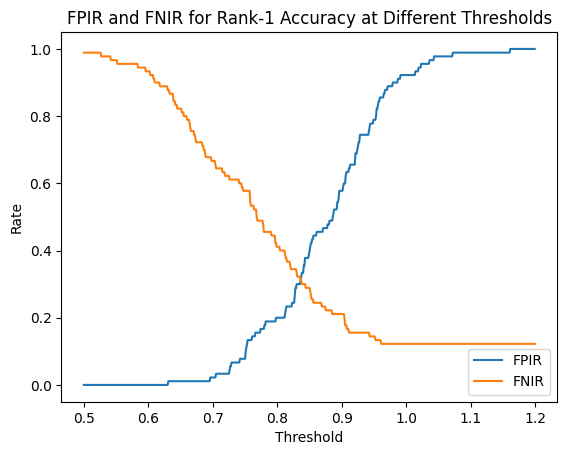

In [ ]:
import matplotlib.pyplot as plt

# สร้าง figure และ axes
fig, ax = plt.subplots()

# วาดเส้นของ FPIR
ax.plot(fpir_fnir_df['Threshold'], fpir_fnir_df['FPIR'], label='FPIR')

# วาดเส้นของ FNIR
ax.plot(fpir_fnir_df['Threshold'], fpir_fnir_df['FNIR'], label='FNIR')

'''# วาดจุดบนเส้น FPIR
for i, txt in enumerate(fpir_fnir_df['FPIR']):
    ax.annotate(txt, (fpir_fnir_df['Threshold'][i], fpir_fnir_df['FPIR'][i]))

# วาดจุดบนเส้น FNIR
for i, txt in enumerate(fpir_fnir_df['FNIR']):
    ax.annotate(txt, (fpir_fnir_df['Threshold'][i], fpir_fnir_df['FNIR'][i]))'''

# ตั้งชื่อแกน x และ y
ax.set_xlabel('Threshold')
ax.set_ylabel('Rate')

# สร้าง legend
ax.legend()

# ตั้งชื่อกราฟ
ax.set_title('FPIR and FNIR for Rank-1 Accuracy at Different Thresholds')

# แสดงกราฟ
plt.show()

## Using DeepFace pipeline

In [ ]:
!pip install deepface

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.8/87.8 kB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 40.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.4/88.4 kB 10.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.2/80.2 kB 11.4 MB/s eta 0:00:00
  Created wheel for fire: filename=fire-0.6.0-py2.py3-none-any.whl size=117031 sha256=1cf2d455ffdd12558abaf2db583e480c96b14b7a129120387b90ef26c2f70ed7
  Stored in directory: /root/.cache/pip/wheels/d6/6d/5d/5b73fa0f46d01a793713f8859201361e9e581ced8c75e5c6a3
Successfully built fire


In [ ]:
from deepface import DeepFace
import numpy as np

# สร้าง embeddings จากภาพที่ align แล้ว
embeddings = []
for img in aligned:
    # แปลง tensor เป็น numpy array
    img_np = img.permute(1, 2, 0).cpu().numpy()
    # สร้าง embedding
    embedding = DeepFace.represent(img_np, enforce_detection=False)
    embeddings.append(embedding)

24-03-12 05:12:34 - Directory /root/.deepface created
24-03-12 05:12:34 - Directory /root/.deepface/weights created
24-03-12 05:12:35 - vgg_face_weights.h5 will be downloaded...


Downloading...
From: https://github.com/serengil/deepface_models/releases/download/v1.0/vgg_face_weights.h5
To: /root/.deepface/weights/vgg_face_weights.h5
100%|██████████| 580M/580M [00:07<00:00, 82.7MB/s]


In [ ]:
# แปลง embeddings จาก list ของ numpy array เป็น PyTorch tensor
embedding = [data[0]['embedding'] for data in embeddings]
embeddings = torch.from_numpy(np.stack(embedding))

In [ ]:
# แปลง embeddings จาก list ของ numpy array เป็น PyTorch tensor
embeddings = torch.from_numpy(np.stack(embeddings)).to(device)

In [ ]:
# สร้าง list ของชื่อที่มีเลขกำกับ
names_with_index = []
count = {}
for name in names:
    if name in count:
        count[name] += 1
    else:
        count[name] = 1
    names_with_index.append(f"{name}{count[name]}")

# แสดง names_with_index
print(names_with_index)


['Emmy1', 'Emmy2', 'Emmy3', 'Emmy4', 'Emmy5', 'Emmy6', 'Emmy7', 'Emmy8', 'Emmy9', 'Emmy10', 'Endu1', 'Endu2', 'Endu3', 'Endu4', 'Endu5', 'Endu6', 'Endu7', 'Endu8', 'Endu9', 'Endu10', 'Fond1', 'Fond2', 'Fond3', 'Fond4', 'Fond5', 'Fond6', 'Fond7', 'Fond8', 'Fond9', 'Fond10', 'Ginna1', 'Ginna2', 'Ginna3', 'Ginna4', 'Ginna5', 'Ginna6', 'Ginna7', 'Ginna8', 'Ginna9', 'Ginna10', 'Grace1', 'Grace2', 'Grace3', 'Grace4', 'Grace5', 'Grace6', 'Grace7', 'Grace8', 'Grace9', 'Grace10', 'Gracenae1', 'Gracenae2', 'Gracenae3', 'Gracenae4', 'Gracenae5', 'Gracenae6', 'Gracenae7', 'Gracenae8', 'Gracenae9', 'Gracenae10', 'Jajah1', 'Jajah2', 'Jajah3', 'Jajah4', 'Jajah5', 'Jajah6', 'Jajah7', 'Jajah8', 'Jajah9', 'Jajah10', 'L1', 'L2', 'L3', 'L4', 'L5', 'L6', 'L7', 'L8', 'L9', 'L10', 'Lookked1', 'Lookked2', 'Lookked3', 'Lookked4', 'Lookked5', 'Lookked6', 'Lookked7', 'Lookked8', 'Lookked9', 'Lookked10', 'Mewyu1', 'Mewyu2', 'Mewyu3', 'Mewyu4', 'Mewyu5', 'Mewyu6', 'Mewyu7', 'Mewyu8', 'Mewyu9', 'Mewyu10', 'Micha1',

In [ ]:
import pandas as pd

# สร้าง dictionary ที่มี key เป็นชื่อและ value เป็น list ของ embeddings
name_to_embeddings = {}
for name, embedding in zip(names_with_index, embeddings):
    if name not in name_to_embeddings:
        name_to_embeddings[name] = []
    name_to_embeddings[name].append(embedding)

# สร้าง list ของชื่อที่มีเลขกำกับ 1 และ list ของชื่อที่มีเลขกำกับที่มากกว่า 1
names_1 = [name for name in name_to_embeddings.keys() if name.endswith('1')]
names_2_plus = [name for name in name_to_embeddings.keys() if not name.endswith('1')]

# คำนวณระยะห่างระหว่าง embeddings
dists = [[(e1 - e2).norm().item() for name1 in names_1 for e2 in name_to_embeddings[name1]] for name2 in names_2_plus for e1 in name_to_embeddings[name2]]

# สร้าง DataFrame
df = pd.DataFrame(dists, columns=names_1, index=names_2_plus)
df

,Emmy1,Endu1,Fond1,Ginna1,Grace1,Gracenae1,Jajah1,L1,Lookked1,Mewyu1,Micha1,Nana1,Paeyah1,Papang1,Pin1,Smild1,XiuZhen1,Yayee1,Yoghurt1,Yuu1
Emmy2,1.156262,1.177594,1.308746,1.319578,1.207145,1.278554,1.286788,1.241171,1.250733,1.323013,1.205923,1.161597,1.239258,1.284582,1.094800,1.108507,1.262492,1.347943,1.286676,1.266127
Emmy3,1.074793,1.059508,1.230139,1.309246,1.091754,1.251919,1.126661,1.177991,1.153672,1.191817,1.214902,1.098940,1.112736,1.205765,1.176140,1.157170,1.247112,1.260268,1.251729,1.218347
Emmy4,0.942857,1.000167,1.231783,1.181848,1.041968,1.033976,1.150916,1.118064,1.063913,1.265999,0.972916,0.966163,1.200534,1.108035,1.069747,1.114291,1.095393,1.143023,1.050514,1.012772
Emmy5,0.868906,1.015884,1.214555,1.250087,1.120484,1.071685,1.031321,1.050241,1.121691,1.279207,1.177063,1.228081,1.186316,1.049226,1.108509,1.153368,1.124310,0.943255,0.993712,1.062274
Emmy6,0.971095,1.094875,1.216838,1.201745,1.170207,1.044015,1.181618,1.121145,1.131456,1.308949,1.137220,1.145167,1.233177,1.244271,1.163787,1.200494,1.097661,1.191802,1.006474,1.033005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Yuu6,0.985862,0.918803,1.175442,1.278790,1.230954,0.971616,1.213609,1.073420,1.130540,1.357033,0.909012,1.127109,1.262451,0.968355,1.032732,1.135010,1.129201,1.252859,0.934047,0.807729
Yuu7,0.969658,0.858860,1.124377,1.202567,1.098745,0.830575,1.082620,1.076950,1.043934,1.279977,1.066025,1.181512,1.213715,0.941841,1.127917,1.108088,0.995608,1.139541,0.799437,0.702419
Yuu8,0.973538,0.871189,1.113408,1.180844,1.061819,0.874984,1.060454,1.056549,1.054241,1.261255,1.085634,1.139964,1.239626,0.892334,1.183774,1.080571,0.953982,1.108041,0.858906,0.813658
Yuu9,0.987612,0.910334,1.140167,1.276730,1.184380,0.908947,1.177867,1.126532,1.106929,1.311255,0.993084,1.134533,1.240156,1.038485,1.066873,1.102807,1.067757,1.242575,0.892266,0.848142


###Vertification

In [ ]:
import pandas as pd
import numpy as np

# สร้าง dictionary ที่มี key เป็นชื่อและ value เป็น list ของ embeddings
name_to_embeddings = {}
for name, embedding in zip(names_with_index, embeddings):
    if name not in name_to_embeddings:
        name_to_embeddings[name] = []
    name_to_embeddings[name].append(embedding)

# สร้าง list ของชื่อที่มีเลขกำกับ 1 และ list ของชื่อที่มีเลขกำกับที่มากกว่า 1
names_1 = [name for name in name_to_embeddings.keys() if name.endswith('1')]
names_2_plus = [name for name in name_to_embeddings.keys() if not name.endswith('1')]

# สร้าง list ของ dictionary สำหรับ DataFrame
data = []

# คำนวณระยะห่างระหว่าง embeddings และเพิ่มข้อมูลลงใน list
count = 0
for name1 in names_1:
    count+=1
    for e2 in name_to_embeddings[name1]:
        for name2 in names_2_plus:
            for e1 in name_to_embeddings[name2]:
                distance = (e1 - e2).norm().item()
                data.append({'Sample_ID': count, 'Claimed identity': name1, 'Actual identity': name2, 'distance': distance})

# แปลง list ของ dictionary เป็น DataFrame
df = pd.DataFrame(data)

In [ ]:
df

,Sample_ID,Claimed identity,Actual identity,distance
0,1,Emmy1,Emmy2,1.156262
1,1,Emmy1,Emmy3,1.074793
2,1,Emmy1,Emmy4,0.942857
3,1,Emmy1,Emmy5,0.868906
4,1,Emmy1,Emmy6,0.971095
...,...,...,...,...
3595,20,Yuu1,Yuu6,0.807729
3596,20,Yuu1,Yuu7,0.702419
3597,20,Yuu1,Yuu8,0.813658
3598,20,Yuu1,Yuu9,0.848142


In [ ]:
# หาจำนวนของ test samples สำหรับแต่ละ user
num_test_samples = df['Claimed identity'].value_counts()

# test samples ทั้งหมด
total_test_samples = sum(df['Claimed identity'].value_counts())
num_test_samples = num_test_samples.append(pd.Series(total_test_samples, index=['Total']))

pd.DataFrame(num_test_samples)

,0
Emmy1,180
Endu1,180
Fond1,180
Ginna1,180
Grace1,180
Gracenae1,180
Jajah1,180
L1,180
Lookked1,180
Mewyu1,180


In [ ]:
# ใช้ฟังก์ชัน exponential ในการคำนวณ score จาก distance
def calculate_score(distance, alpha=1.0):
    return np.exp(-alpha * distance)

# คำนวณ score จาก distance
score = df['distance'].apply(calculate_score)

# ใช้ percentile ที่ 95 เป็น threshold
threshold = np.percentile(score, 95)

thresholds = score.sort_values(ascending=True)
thresholds = thresholds.reset_index(drop=True)

# เปลี่ยนชื่อ column จาก 'distance' เป็น 'threshold'
thresholds.name = 'threshold'

pd.DataFrame(thresholds)

,threshold
0,0.248702
1,0.249013
2,0.249249
3,0.249947
4,0.249965
...,...
3595,0.494143
3596,0.495386
3597,0.496670
3598,0.509023


In [ ]:
# คำนวณ FAR และ FRR
FARs = []
FRRs = []
thresholdstodf = []
for threshold in np.arange(df["distance"].min(),df["distance"].max(),0.01):

    thresholdstodf.append(threshold)
    # False Acceptance Rate: ความน่าจะเป็นที่จะยอมรับข้อความที่ไม่ถูกต้อง
    FAR = np.sum((df['Claimed identity'].str.replace(r'\d+', '') != df['Actual identity'].str.replace(r'\d+', '')) & (df['distance'] <= threshold)) / np.sum(df['Claimed identity'].str.replace(r'\d+', '') != df['Actual identity'].str.replace(r'\d+', ''))
    FARs.append(FAR)

    # False Rejection Rate: ความน่าจะเป็นที่จะปฏิเสธข้อความที่ถูกต้อง
    FRR = np.sum((df['Claimed identity'].str.replace(r'\d+', '') == df['Actual identity'].str.replace(r'\d+', '')) & (df['distance'] > threshold)) / np.sum(df['Claimed identity'].str.replace(r'\d+', '') == df['Actual identity'].str.replace(r'\d+', ''))
    FRRs.append(FRR)

# สร้าง DataFrame ของ FAR และ FRR
far_frr_df = pd.DataFrame({'Threshold': thresholdstodf, 'FAR': FARs, 'FRR': FRRs})


In [ ]:
far_frr_df

,Threshold,FAR,FRR
0,0.618257,0.000000,0.994444
1,0.628257,0.000000,0.994444
2,0.638257,0.000000,0.994444
3,0.648257,0.000000,0.994444
4,0.658257,0.000000,0.994444
...,...,...,...
73,1.348257,0.992690,0.005556
74,1.358257,0.995614,0.005556
75,1.368257,0.995906,0.005556
76,1.378257,0.997953,0.000000


<Axes: >

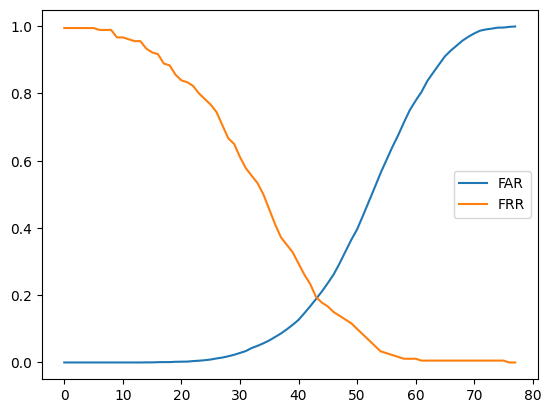

In [ ]:
far_frr_df[['FAR','FRR']].plot()

In [ ]:
# คำนวณ EER
eer_threshold = far_frr_df.iloc[(far_frr_df['FAR'] - far_frr_df['FRR']).abs().idxmin()]['Threshold']
eer = (far_frr_df.iloc[(far_frr_df['FAR'] - far_frr_df['FRR']).abs().idxmin()]['FAR'] + far_frr_df.iloc[(far_frr_df['FAR'] - far_frr_df['FRR']).abs().idxmin()]['FRR']) / 2

eer_threshold, eer

(1.0482567917644623, 0.19166666666666665)

In [ ]:
# สร้าง list ของ dictionary ที่มีข้อมูล FAR และ FRR ของแต่ละ user
user_far_frr_data = [{'User': user,
                      'FAR': np.sum((df['Claimed identity'].str.replace(r'\d+', '') != user) & (df['distance'] >= eer_threshold)) / np.sum(df['Claimed identity'].str.replace(r'\d+', '') != user),
                      'FRR': np.sum((df['Claimed identity'].str.replace(r'\d+', '') == user) & (df['distance'] < eer_threshold)) / np.sum(df['Claimed identity'].str.replace(r'\d+', '') == user)}
                     for user in df['Actual identity'].str.replace(r'\d+', '').unique()]

# สร้าง DataFrame จาก list ของ dictionary
user_far_frr_df = pd.DataFrame(user_far_frr_data)

In [ ]:
user_far_frr_df

,User,FAR,FRR
0,Emmy,0.788304,0.372222
1,Endu,0.792398,0.450000
2,Fond,0.776901,0.155556
3,Ginna,0.772222,0.066667
4,Grace,0.777485,0.166667
5,Gracenae,0.785380,0.316667
6,Jajah,0.781287,0.238889
7,L,0.779825,0.211111
8,Lookked,0.785673,0.322222
9,Mewyu,0.771345,0.050000


<Axes: xlabel='User'>

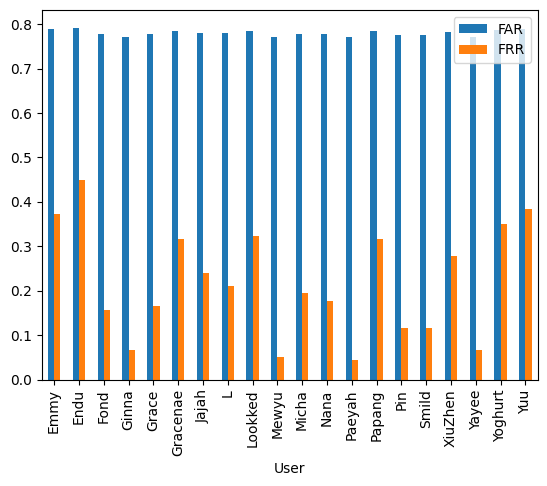

In [ ]:
user_far_frr_df.plot(kind='bar', x='User')

### Identification

In [ ]:
import pandas as pd

# สร้าง dictionary ที่มี key เป็นชื่อและ value เป็น list ของ embeddings
name_to_embeddings = {}
for name, embedding in zip(names_with_index, embeddings):
    if name not in name_to_embeddings:
        name_to_embeddings[name] = []
    name_to_embeddings[name].append(embedding)

# สร้าง list ของชื่อที่มีเลขกำกับ 1 และ list ของชื่อที่มีเลขกำกับที่มากกว่า 1
names_1 = [name for name in name_to_embeddings.keys() if name.endswith('1')]
names_2_plus = [name for name in name_to_embeddings.keys() if not name.endswith('1')]

# คำนวณระยะห่างระหว่าง embeddings
dists = [[(e1 - e2).norm().item() for name1 in names_1 for e2 in name_to_embeddings[name1]] for name2 in names_2_plus for e1 in name_to_embeddings[name2]]

# สร้าง DataFrame
df = pd.DataFrame(dists, columns=names_1, index=names_2_plus)
df

,Emmy1,Endu1,Fond1,Ginna1,Grace1,Gracenae1,Jajah1,L1,Lookked1,Mewyu1,Micha1,Nana1,Paeyah1,Papang1,Pin1,Smild1,XiuZhen1,Yayee1,Yoghurt1,Yuu1
Emmy2,1.156262,1.177594,1.308746,1.319578,1.207145,1.278554,1.286788,1.241171,1.250733,1.323013,1.205923,1.161597,1.239258,1.284582,1.094800,1.108507,1.262492,1.347943,1.286676,1.266127
Emmy3,1.074793,1.059508,1.230139,1.309246,1.091754,1.251919,1.126661,1.177991,1.153672,1.191817,1.214902,1.098940,1.112736,1.205765,1.176140,1.157170,1.247112,1.260268,1.251729,1.218347
Emmy4,0.942857,1.000167,1.231783,1.181848,1.041968,1.033976,1.150916,1.118064,1.063913,1.265999,0.972916,0.966163,1.200534,1.108035,1.069747,1.114291,1.095393,1.143023,1.050514,1.012772
Emmy5,0.868906,1.015884,1.214555,1.250087,1.120484,1.071685,1.031321,1.050241,1.121691,1.279207,1.177063,1.228081,1.186316,1.049226,1.108509,1.153368,1.124310,0.943255,0.993712,1.062274
Emmy6,0.971095,1.094875,1.216838,1.201745,1.170207,1.044015,1.181618,1.121145,1.131456,1.308949,1.137220,1.145167,1.233177,1.244271,1.163787,1.200494,1.097661,1.191802,1.006474,1.033005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Yuu6,0.985862,0.918803,1.175442,1.278790,1.230954,0.971616,1.213609,1.073420,1.130540,1.357033,0.909012,1.127109,1.262451,0.968355,1.032732,1.135010,1.129201,1.252859,0.934047,0.807729
Yuu7,0.969658,0.858860,1.124377,1.202567,1.098745,0.830575,1.082620,1.076950,1.043934,1.279977,1.066025,1.181512,1.213715,0.941841,1.127917,1.108088,0.995608,1.139541,0.799437,0.702419
Yuu8,0.973538,0.871189,1.113408,1.180844,1.061819,0.874984,1.060454,1.056549,1.054241,1.261255,1.085634,1.139964,1.239626,0.892334,1.183774,1.080571,0.953982,1.108041,0.858906,0.813658
Yuu9,0.987612,0.910334,1.140167,1.276730,1.184380,0.908947,1.177867,1.126532,1.106929,1.311255,0.993084,1.134533,1.240156,1.038485,1.066873,1.102807,1.067757,1.242575,0.892266,0.848142


In [ ]:
# สร้าง close set
close_set_names = names_1
close_set_row = names_2_plus
close_set_df = df.loc[close_set_row,close_set_names]

# สร้าง open set
open_set_df = df.loc[:,close_set_names[:10]]
close_set_df

,Emmy1,Endu1,Fond1,Ginna1,Grace1,Gracenae1,Jajah1,L1,Lookked1,Mewyu1,Micha1,Nana1,Paeyah1,Papang1,Pin1,Smild1,XiuZhen1,Yayee1,Yoghurt1,Yuu1
Emmy2,1.156262,1.177594,1.308746,1.319578,1.207145,1.278554,1.286788,1.241171,1.250733,1.323013,1.205923,1.161597,1.239258,1.284582,1.094800,1.108507,1.262492,1.347943,1.286676,1.266127
Emmy3,1.074793,1.059508,1.230139,1.309246,1.091754,1.251919,1.126661,1.177991,1.153672,1.191817,1.214902,1.098940,1.112736,1.205765,1.176140,1.157170,1.247112,1.260268,1.251729,1.218347
Emmy4,0.942857,1.000167,1.231783,1.181848,1.041968,1.033976,1.150916,1.118064,1.063913,1.265999,0.972916,0.966163,1.200534,1.108035,1.069747,1.114291,1.095393,1.143023,1.050514,1.012772
Emmy5,0.868906,1.015884,1.214555,1.250087,1.120484,1.071685,1.031321,1.050241,1.121691,1.279207,1.177063,1.228081,1.186316,1.049226,1.108509,1.153368,1.124310,0.943255,0.993712,1.062274
Emmy6,0.971095,1.094875,1.216838,1.201745,1.170207,1.044015,1.181618,1.121145,1.131456,1.308949,1.137220,1.145167,1.233177,1.244271,1.163787,1.200494,1.097661,1.191802,1.006474,1.033005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Yuu6,0.985862,0.918803,1.175442,1.278790,1.230954,0.971616,1.213609,1.073420,1.130540,1.357033,0.909012,1.127109,1.262451,0.968355,1.032732,1.135010,1.129201,1.252859,0.934047,0.807729
Yuu7,0.969658,0.858860,1.124377,1.202567,1.098745,0.830575,1.082620,1.076950,1.043934,1.279977,1.066025,1.181512,1.213715,0.941841,1.127917,1.108088,0.995608,1.139541,0.799437,0.702419
Yuu8,0.973538,0.871189,1.113408,1.180844,1.061819,0.874984,1.060454,1.056549,1.054241,1.261255,1.085634,1.139964,1.239626,0.892334,1.183774,1.080571,0.953982,1.108041,0.858906,0.813658
Yuu9,0.987612,0.910334,1.140167,1.276730,1.184380,0.908947,1.177867,1.126532,1.106929,1.311255,0.993084,1.134533,1.240156,1.038485,1.066873,1.102807,1.067757,1.242575,0.892266,0.848142


##### Close set

In [ ]:
# 1. Close set identification
# Number of probes
num_probes_close = len(close_set_df)
num_probes_close

180

In [ ]:
# Number of probes for each user
names_without_numbers = close_set_df.index.str.replace(r'\d+$', '')
num_probes_per_user_close = names_without_numbers.value_counts()

pd.DataFrame(num_probes_per_user_close)

,0
Emmy,9
Endu,9
Yoghurt,9
Yayee,9
XiuZhen,9
Smild,9
Pin,9
Papang,9
Paeyah,9
Nana,9


In [ ]:
# Number of templates
num_templates_close = len(close_set_df.columns)
num_templates_close

20

In [ ]:
# สร้าง DataFrame ใหม่จาก close_set_df
close_set_Rank_test = close_set_df.copy()

# เพิ่มการทดลอง identify เป็นคอลัมน์ใน close_set_Rank_test
close_set_Rank_test['Rank_1_Identify'] = close_set_df.apply(lambda x: x.astype(float).nsmallest(3).index[0], axis=1)
close_set_Rank_test['Rank_2_Identify'] = close_set_df.apply(lambda x: x.astype(float).nsmallest(3).index[1], axis=1)
close_set_Rank_test['Rank_3_Identify'] = close_set_df.apply(lambda x: x.astype(float).nsmallest(3).index[2], axis=1)

close_set_Rank_test

,Emmy1,Endu1,Fond1,Ginna1,Grace1,Gracenae1,Jajah1,L1,Lookked1,Mewyu1,...,Papang1,Pin1,Smild1,XiuZhen1,Yayee1,Yoghurt1,Yuu1,Rank_1_Identify,Rank_2_Identify,Rank_3_Identify
Emmy2,1.156262,1.177594,1.308746,1.319578,1.207145,1.278554,1.286788,1.241171,1.250733,1.323013,...,1.284582,1.094800,1.108507,1.262492,1.347943,1.286676,1.266127,Pin1,Smild1,Emmy1
Emmy3,1.074793,1.059508,1.230139,1.309246,1.091754,1.251919,1.126661,1.177991,1.153672,1.191817,...,1.205765,1.176140,1.157170,1.247112,1.260268,1.251729,1.218347,Endu1,Emmy1,Grace1
Emmy4,0.942857,1.000167,1.231783,1.181848,1.041968,1.033976,1.150916,1.118064,1.063913,1.265999,...,1.108035,1.069747,1.114291,1.095393,1.143023,1.050514,1.012772,Emmy1,Nana1,Micha1
Emmy5,0.868906,1.015884,1.214555,1.250087,1.120484,1.071685,1.031321,1.050241,1.121691,1.279207,...,1.049226,1.108509,1.153368,1.124310,0.943255,0.993712,1.062274,Emmy1,Yayee1,Yoghurt1
Emmy6,0.971095,1.094875,1.216838,1.201745,1.170207,1.044015,1.181618,1.121145,1.131456,1.308949,...,1.244271,1.163787,1.200494,1.097661,1.191802,1.006474,1.033005,Emmy1,Yoghurt1,Yuu1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Yuu6,0.985862,0.918803,1.175442,1.278790,1.230954,0.971616,1.213609,1.073420,1.130540,1.357033,...,0.968355,1.032732,1.135010,1.129201,1.252859,0.934047,0.807729,Yuu1,Micha1,Endu1
Yuu7,0.969658,0.858860,1.124377,1.202567,1.098745,0.830575,1.082620,1.076950,1.043934,1.279977,...,0.941841,1.127917,1.108088,0.995608,1.139541,0.799437,0.702419,Yuu1,Yoghurt1,Gracenae1
Yuu8,0.973538,0.871189,1.113408,1.180844,1.061819,0.874984,1.060454,1.056549,1.054241,1.261255,...,0.892334,1.183774,1.080571,0.953982,1.108041,0.858906,0.813658,Yuu1,Yoghurt1,Endu1
Yuu9,0.987612,0.910334,1.140167,1.276730,1.184380,0.908947,1.177867,1.126532,1.106929,1.311255,...,1.038485,1.066873,1.102807,1.067757,1.242575,0.892266,0.848142,Yuu1,Yoghurt1,Gracenae1


In [ ]:
# สร้างฟังก์ชันเพื่อตรวจสอบว่าค่าที่ถูกต้องอยู่ในอันดับที่ 1, 2 หรือ 3 หรือไม่
def check_rank(row):
    index_stripped = row.name.rstrip('1234567890')
    return (row['Rank_1_Identify'].rstrip('1234567890') == index_stripped,
            row['Rank_2_Identify'].rstrip('1234567890') == index_stripped,
            row['Rank_3_Identify'].rstrip('1234567890') == index_stripped)

# ใช้ฟังก์ชัน check_rank กับ DataFrame
ranks = close_set_Rank_test.apply(check_rank, axis=1, result_type='expand')

In [ ]:
ranks

,0,1,2
Emmy2,False,False,True
Emmy3,False,True,False
Emmy4,True,False,False
Emmy5,True,False,False
Emmy6,True,False,False
...,...,...,...
Yuu6,True,False,False
Yuu7,True,False,False
Yuu8,True,False,False
Yuu9,True,False,False


In [ ]:
# คำนวณความแม่นยำของ Rank-1, Rank-2 และ Rank-3
rank_1_accuracy = ranks[0].mean()
rank_2_accuracy = ranks[[0, 1]].any(axis=1).mean()
rank_3_accuracy = ranks.any(axis=1).mean()

rank_1_accuracy, rank_2_accuracy, rank_3_accuracy

(0.5166666666666667, 0.7166666666666667, 0.7833333333333333)

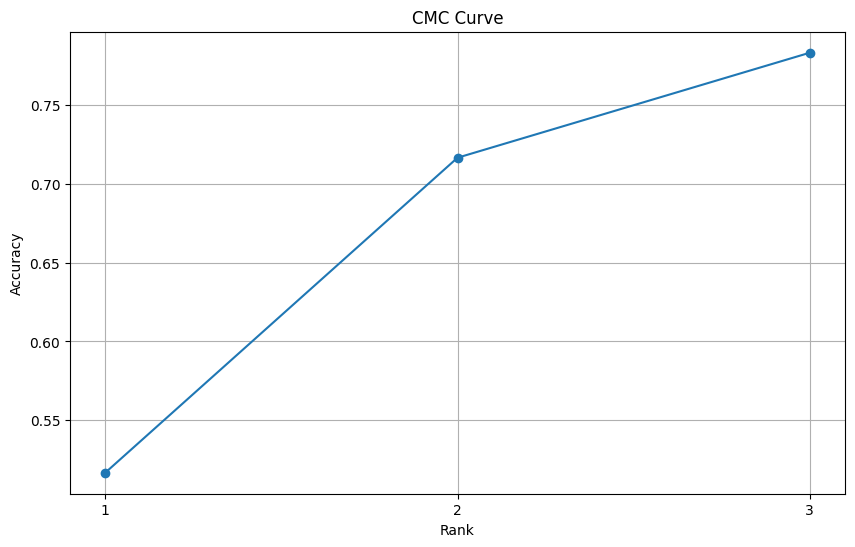

In [ ]:
import matplotlib.pyplot as plt

# ความแม่นยำของ Rank-1, Rank-2 และ Rank-3 ที่คุณได้จากการคำนวณ
accuracies = [rank_1_accuracy, rank_2_accuracy, rank_3_accuracy]

# สร้าง CMC curve
plt.figure(figsize=(10, 6))
plt.plot(range(1, 4), accuracies, marker='o')
plt.xticks(range(1, 4))
plt.xlabel('Rank')
plt.ylabel('Accuracy')
plt.title('CMC Curve')
plt.grid(True)
plt.show()


#### Open set

In [ ]:
open_set_df

,Emmy1,Endu1,Fond1,Ginna1,Grace1,Gracenae1,Jajah1,L1,Lookked1,Mewyu1
Emmy2,1.156262,1.177594,1.308746,1.319578,1.207145,1.278554,1.286788,1.241171,1.250733,1.323013
Emmy3,1.074793,1.059508,1.230139,1.309246,1.091754,1.251919,1.126661,1.177991,1.153672,1.191817
Emmy4,0.942857,1.000167,1.231783,1.181848,1.041968,1.033976,1.150916,1.118064,1.063913,1.265999
Emmy5,0.868906,1.015884,1.214555,1.250087,1.120484,1.071685,1.031321,1.050241,1.121691,1.279207
Emmy6,0.971095,1.094875,1.216838,1.201745,1.170207,1.044015,1.181618,1.121145,1.131456,1.308949
...,...,...,...,...,...,...,...,...,...,...
Yuu6,0.985862,0.918803,1.175442,1.278790,1.230954,0.971616,1.213609,1.073420,1.130540,1.357033
Yuu7,0.969658,0.858860,1.124377,1.202567,1.098745,0.830575,1.082620,1.076950,1.043934,1.279977
Yuu8,0.973538,0.871189,1.113408,1.180844,1.061819,0.874984,1.060454,1.056549,1.054241,1.261255
Yuu9,0.987612,0.910334,1.140167,1.276730,1.184380,0.908947,1.177867,1.126532,1.106929,1.311255


In [ ]:
# Number of probes for each user
names_without_numbers = open_set_df.index.str.replace(r'\d+$', '')
num_probes_per_user_open = names_without_numbers.value_counts()

AllMember = pd.DataFrame(num_probes_per_user_open)
AllMember

,0
Emmy,9
Endu,9
Yoghurt,9
Yayee,9
XiuZhen,9
Smild,9
Pin,9
Papang,9
Paeyah,9
Nana,9


In [ ]:
EnrollMemer = AllMember.iloc[:10]


EnrollMemerCount = len(EnrollMemer)
EnrollMemer

,0
Emmy,9
Endu,9
Yoghurt,9
Yayee,9
XiuZhen,9
Smild,9
Pin,9
Papang,9
Paeyah,9
Nana,9


In [ ]:
UnknownMemer = AllMember.iloc[10:]

UnknownMemerCount = len(UnknownMemer)
UnknownMemer

,0
Micha,9
Mewyu,9
Lookked,9
L,9
Jajah,9
Gracenae,9
Grace,9
Ginna,9
Fond,9
Yuu,9


In [ ]:
# Number of templates
num_templates_open = len(open_set_df.columns)
num_templates_open

10

In [ ]:
# คำนวณค่า quantile ที่ 25
qtest = open_set_df.quantile(0.10, axis=1)

# คำนวณค่า quantile ที่ 10, 20, ..., 90
quantiles = [qtest.quantile(i/100) for i in range(10, 100, 5)]

# ใช้ค่า quantile เป็น threshold
thresholds = quantiles

In [ ]:
thresholds

[0.912374239370043,
 0.932766917126998,
 0.9532868921938819,
 0.9716110294451454,
 0.9836628421976625,
 0.9944192500467551,
 1.0034657638730973,
 1.0106212907340153,
 1.0239864865213328,
 1.0360033501712047,
 1.0391725132443388,
 1.0506330115516158,
 1.0582688970341712,
 1.0734189626134938,
 1.0825184102964567,
 1.0945571231632447,
 1.1050487501135928,
 1.1259260898198624]

In [ ]:
# สร้าง DataFrame ใหม่จาก open_set_df
open_set_Rank_test = open_set_df.copy()

# เพิ่มการทดลอง identify เป็นคอลัมน์ใน open_set_Rank_test
open_set_Rank_test['Rank_1_Identify'] = open_set_df.apply(lambda x: x.astype(float).nsmallest(3).index[0], axis=1)

for t in thresholds:
  open_set_Rank_test[f'Rank_1_Threshold {t}'] = open_set_df.apply(lambda x: x.astype(float).nsmallest(3).index[0] if x.astype(float).nsmallest(3)[0] < t else 'reject', axis=1)

open_set_Rank_test

,Emmy1,Endu1,Fond1,Ginna1,Grace1,Gracenae1,Jajah1,L1,Lookked1,Mewyu1,...,Rank_1_Threshold 1.0239864865213328,Rank_1_Threshold 1.0360033501712047,Rank_1_Threshold 1.0391725132443388,Rank_1_Threshold 1.0506330115516158,Rank_1_Threshold 1.0582688970341712,Rank_1_Threshold 1.0734189626134938,Rank_1_Threshold 1.0825184102964567,Rank_1_Threshold 1.0945571231632447,Rank_1_Threshold 1.1050487501135928,Rank_1_Threshold 1.1259260898198624
Emmy2,1.156262,1.177594,1.308746,1.319578,1.207145,1.278554,1.286788,1.241171,1.250733,1.323013,...,reject,reject,reject,reject,reject,reject,reject,reject,reject,reject
Emmy3,1.074793,1.059508,1.230139,1.309246,1.091754,1.251919,1.126661,1.177991,1.153672,1.191817,...,reject,reject,reject,reject,reject,Endu1,Endu1,Endu1,Endu1,Endu1
Emmy4,0.942857,1.000167,1.231783,1.181848,1.041968,1.033976,1.150916,1.118064,1.063913,1.265999,...,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1
Emmy5,0.868906,1.015884,1.214555,1.250087,1.120484,1.071685,1.031321,1.050241,1.121691,1.279207,...,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1
Emmy6,0.971095,1.094875,1.216838,1.201745,1.170207,1.044015,1.181618,1.121145,1.131456,1.308949,...,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Yuu6,0.985862,0.918803,1.175442,1.278790,1.230954,0.971616,1.213609,1.073420,1.130540,1.357033,...,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1
Yuu7,0.969658,0.858860,1.124377,1.202567,1.098745,0.830575,1.082620,1.076950,1.043934,1.279977,...,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1
Yuu8,0.973538,0.871189,1.113408,1.180844,1.061819,0.874984,1.060454,1.056549,1.054241,1.261255,...,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1
Yuu9,0.987612,0.910334,1.140167,1.276730,1.184380,0.908947,1.177867,1.126532,1.106929,1.311255,...,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1


In [ ]:
EnrollMemer_rank = open_set_Rank_test.iloc[:10*9]
EnrollMemer_rank

,Emmy1,Endu1,Fond1,Ginna1,Grace1,Gracenae1,Jajah1,L1,Lookked1,Mewyu1,...,Rank_1_Threshold 1.0239864865213328,Rank_1_Threshold 1.0360033501712047,Rank_1_Threshold 1.0391725132443388,Rank_1_Threshold 1.0506330115516158,Rank_1_Threshold 1.0582688970341712,Rank_1_Threshold 1.0734189626134938,Rank_1_Threshold 1.0825184102964567,Rank_1_Threshold 1.0945571231632447,Rank_1_Threshold 1.1050487501135928,Rank_1_Threshold 1.1259260898198624
Emmy2,1.156262,1.177594,1.308746,1.319578,1.207145,1.278554,1.286788,1.241171,1.250733,1.323013,...,reject,reject,reject,reject,reject,reject,reject,reject,reject,reject
Emmy3,1.074793,1.059508,1.230139,1.309246,1.091754,1.251919,1.126661,1.177991,1.153672,1.191817,...,reject,reject,reject,reject,reject,Endu1,Endu1,Endu1,Endu1,Endu1
Emmy4,0.942857,1.000167,1.231783,1.181848,1.041968,1.033976,1.150916,1.118064,1.063913,1.265999,...,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1
Emmy5,0.868906,1.015884,1.214555,1.250087,1.120484,1.071685,1.031321,1.050241,1.121691,1.279207,...,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1
Emmy6,0.971095,1.094875,1.216838,1.201745,1.170207,1.044015,1.181618,1.121145,1.131456,1.308949,...,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Mewyu6,1.279763,1.286065,1.248051,1.182703,1.198783,1.314684,1.123712,1.242893,1.196406,1.003568,...,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1
Mewyu7,1.276260,1.203353,1.218087,1.136187,1.178087,1.225489,1.062700,1.219046,1.092202,0.958069,...,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1
Mewyu8,1.224702,1.168824,1.118963,1.126734,1.103362,1.206725,1.057195,1.135933,1.001726,1.041166,...,Lookked1,Lookked1,Lookked1,Lookked1,Lookked1,Lookked1,Lookked1,Lookked1,Lookked1,Lookked1
Mewyu9,1.291648,1.300016,1.202641,1.166547,1.143627,1.293547,1.101473,1.230663,1.168200,0.961992,...,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1,Mewyu1


In [ ]:
UnknownMemer_rank = open_set_Rank_test.iloc[10*9:]
UnknownMemer_rank

,Emmy1,Endu1,Fond1,Ginna1,Grace1,Gracenae1,Jajah1,L1,Lookked1,Mewyu1,...,Rank_1_Threshold 1.0239864865213328,Rank_1_Threshold 1.0360033501712047,Rank_1_Threshold 1.0391725132443388,Rank_1_Threshold 1.0506330115516158,Rank_1_Threshold 1.0582688970341712,Rank_1_Threshold 1.0734189626134938,Rank_1_Threshold 1.0825184102964567,Rank_1_Threshold 1.0945571231632447,Rank_1_Threshold 1.1050487501135928,Rank_1_Threshold 1.1259260898198624
Micha2,1.045295,1.079661,1.174732,1.227677,1.073085,1.089038,1.091575,1.113296,1.108728,1.206650,...,reject,reject,reject,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1
Micha3,1.089488,1.029984,1.136571,1.210014,1.125921,1.011498,1.163477,1.149060,1.148254,1.269785,...,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1
Micha4,0.920610,1.039853,1.190086,1.255142,1.108607,1.039970,1.103764,1.054863,1.102550,1.282339,...,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1,Emmy1
Micha5,1.002540,0.955747,1.156771,1.247412,1.057411,1.059066,1.143221,1.084920,1.076695,1.286266,...,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1
Micha6,1.179561,1.115770,1.239555,1.241613,1.090956,1.138009,1.171779,1.223465,1.180949,1.199002,...,reject,reject,reject,reject,reject,reject,reject,Grace1,Grace1,Grace1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Yuu6,0.985862,0.918803,1.175442,1.278790,1.230954,0.971616,1.213609,1.073420,1.130540,1.357033,...,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1
Yuu7,0.969658,0.858860,1.124377,1.202567,1.098745,0.830575,1.082620,1.076950,1.043934,1.279977,...,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1
Yuu8,0.973538,0.871189,1.113408,1.180844,1.061819,0.874984,1.060454,1.056549,1.054241,1.261255,...,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1,Endu1
Yuu9,0.987612,0.910334,1.140167,1.276730,1.184380,0.908947,1.177867,1.126532,1.106929,1.311255,...,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1,Gracenae1


In [ ]:
# สร้าง DataFrame สำหรับเก็บค่า FPIR และ FNIR
fpir_fnir_df = pd.DataFrame(columns=['Threshold', 'FPIR', 'FNIR'])


# วนลูปเพื่อคำนวณค่า FPIR และ FNIR ที่แต่ละ threshold

def check_rankThershold(row, threshold):
    index_stripped = row.name.rstrip('1234567890')
    return (row[f'Rank_1_Threshold {t}'].rstrip('1234567890') == index_stripped)    #Will return Ture or Flase

for t in thresholds:
    # คำนวณค่า FPIR และ FNIR
    fpir = len(UnknownMemer_rank[UnknownMemer_rank[f'Rank_1_Threshold {t}'] != 'reject']) / len(UnknownMemer_rank)
    fnir = 1 - (sum(EnrollMemer_rank.apply(check_rankThershold,args=(t,), axis=1)/ len(EnrollMemer_rank)))      #Sum is the total of True Match

    # เพิ่มค่า FPIR และ FNIR ลงใน DataFrame
    fpir_fnir_df = fpir_fnir_df.append({'Threshold': t, 'FPIR': fpir, 'FNIR': fnir}, ignore_index=True)

In [ ]:
fpir_fnir_df

,Threshold,FPIR,FNIR
0,0.912374,0.211111,0.677778
1,0.932767,0.322222,0.622222
2,0.953287,0.388889,0.566667
3,0.971611,0.455556,0.500000
4,0.983663,0.533333,0.455556
5,0.994419,0.544444,0.444444
6,1.003466,0.577778,0.411111
7,1.010621,0.600000,0.400000
8,1.023986,0.644444,0.366667
9,1.036003,0.711111,0.355556


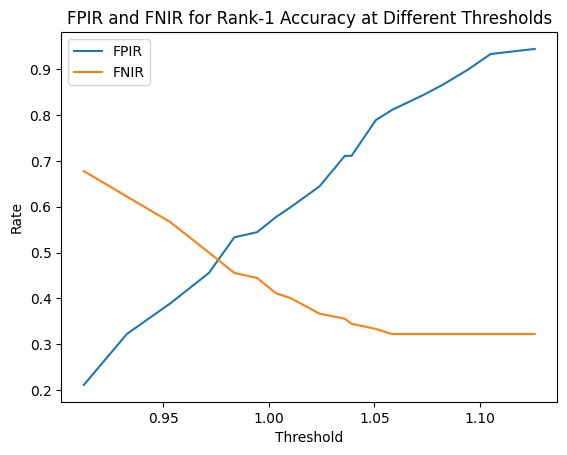

In [ ]:
import matplotlib.pyplot as plt

# สร้าง figure และ axes
fig, ax = plt.subplots()

# วาดเส้นของ FPIR
ax.plot(fpir_fnir_df['Threshold'], fpir_fnir_df['FPIR'], label='FPIR')

# วาดเส้นของ FNIR
ax.plot(fpir_fnir_df['Threshold'], fpir_fnir_df['FNIR'], label='FNIR')

'''# วาดจุดบนเส้น FPIR
for i, txt in enumerate(fpir_fnir_df['FPIR']):
    ax.annotate(txt, (fpir_fnir_df['Threshold'][i], fpir_fnir_df['FPIR'][i]))

# วาดจุดบนเส้น FNIR
for i, txt in enumerate(fpir_fnir_df['FNIR']):
    ax.annotate(txt, (fpir_fnir_df['Threshold'][i], fpir_fnir_df['FNIR'][i]))'''

# ตั้งชื่อแกน x และ y
ax.set_xlabel('Threshold')
ax.set_ylabel('Rate')

# สร้าง legend
ax.legend()

# ตั้งชื่อกราฟ
ax.set_title('FPIR and FNIR for Rank-1 Accuracy at Different Thresholds')

# แสดงกราฟ
plt.show()

In [ ]:
import numpy as np
from scipy import linalg
A=np.array([[1,2,3],[3,4,5],[5,6,7],[7,8,9]])
Q, R = linalg.qr(A, mode='economic')
Q

array([[-0.10910895, -0.82951506,  0.54048488],
       [-0.32732684, -0.43915503, -0.65449812],
       [-0.54554473, -0.048795  , -0.3124584 ],
       [-0.76376262,  0.34156503,  0.42647164]])